In [6]:
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras import layers
from tensorflow.keras import activations
from tensorflow.keras.callbacks import TensorBoard
from tensorflow.keras.models import load_model
from keras import activations
import numpy as np
import pickle
import os
from keras.models import load_model
from skimage.transform import resize
from tqdm import tqdm
import copy
import matplotlib.pyplot as plt
from sklearn.metrics import mean_squared_error

"""
##### ***Data & Black-Box***

"""

# IMPORTO I DATI PER VOTTIGNASCO


# Ottieni il percorso effettivo da una variabile d'ambiente
work_path = os.environ['WORK']  # Ottieni il valore della variabile d'ambiente WORK
v_test_OHE_path = os.path.join(work_path, "Water_Resources/rise-video/data/Vottignasco/Vottignasco_00425010001_test_month_OHE.npy")
v_test_image_path = os.path.join(work_path, "Water_Resources/rise-video/data/Vottignasco/Vottignasco_00425010001_test_normalized_image_sequences.npy")
v_test_target_dates_path = os.path.join(work_path, "Water_Resources/rise-video/data/Vottignasco/Vottignasco_00425010001_test_target_dates.npy")
v_test_images_test_dates = os.path.join(work_path, "Water_Resources/rise-video/data/Vottignasco/Vottignasco_00425010001_test_image_sequences_dates.npy")

# Carica l'array numpy dai file
vottignasco_test_OHE    = np.load(v_test_OHE_path)
vottignasco_test_image  = np.load(v_test_image_path)
vottignasco_test_dates  = np.load(v_test_target_dates_path)
vottignasco_test_images_dates = np.load(v_test_images_test_dates)

print(len(vottignasco_test_dates))
print(len(vottignasco_test_image))
print(len(vottignasco_test_OHE))
print(len(vottignasco_test_images_dates))

105
105
105
105


In [8]:
import pickle

#results_setups_path = "./MyDrive/Water_Resources/wr_extensions/superpixels_versions/LIME/last_try/Temporal/results/lime_temporal_insertion_deletion_results_setup_kw_80_alpha_0.pkl"
path_to_load_results = os.path.join(work_path, "Water_Resources/rise-video/XAI/spatial_temporal/results/lime_shap_multiplicative_norm_zero/")
results_string_name  = f"lime_shap_st_results_setup_ns_8_comp_15.pkl"

# Apri il file in modalità lettura binaria ('rb')
with open(path_to_load_results + results_string_name, 'rb') as file:
    lime_shap_st_results = pickle.load(file)

In [10]:
for key in lime_shap_st_results["lime"]:
    print(key)

ns_8_comp_15_kw_80_alpha_0.1
ns_8_comp_15_kw_85_alpha_0.1
ns_8_comp_15_kw_90_alpha_0.1
ns_8_comp_15_kw_95_alpha_0.1
ns_8_comp_15_kw_80_alpha_1.0
ns_8_comp_15_kw_85_alpha_1.0
ns_8_comp_15_kw_90_alpha_1.0
ns_8_comp_15_kw_95_alpha_1.0
ns_8_comp_15_kw_80_alpha_10.0
ns_8_comp_15_kw_85_alpha_10.0
ns_8_comp_15_kw_90_alpha_10.0
ns_8_comp_15_kw_95_alpha_10.0
ns_8_comp_15_kw_80_alpha_100.0
ns_8_comp_15_kw_85_alpha_100.0
ns_8_comp_15_kw_90_alpha_100.0
ns_8_comp_15_kw_95_alpha_100.0


In [12]:
parameter_combinations = next(iter(lime_shap_st_results["lime"]))
print(parameter_combinations)

ns_8_comp_15_kw_80_alpha_0.1


In [17]:
def plot_mean_insertion_curve(all_errors_insertion):
  max_len = max(map(len, all_errors_insertion))

  # Padding con NaN per ottenere una matrice rettangolare
  padded_array = np.full((len(all_errors_insertion), max_len), np.nan)
  for i, row in enumerate(all_errors_insertion):
    padded_array[i, :len(row)] = row  # Riempie solo le parti esistenti
  # Calcola la media ignorando i NaN
  mean_errors_for_insertion_vott = np.nanmean(padded_array, axis=0)
  #print("Mean Errors for Nr of Pixel Inserted, Vottignasco: \n", mean_errors_for_insertion_vott)

  # Plot della curva dell'errore e area sotto la curva (AUC)
  x = np.arange(0, mean_errors_for_insertion_vott.shape[0])
  plt.plot(x, mean_errors_for_insertion_vott, label='Error Curve')
  # Pallini blu sui punti della curva
  plt.scatter(x, mean_errors_for_insertion_vott, color='blue', zorder=3)
  plt.fill_between(x, mean_errors_for_insertion_vott, color='skyblue', alpha=0.4)
  plt.xlabel('Nr of SuperPixels inserted')
  plt.ylabel('Mean Squared Error')
  plt.grid(True, linestyle='--', alpha=0.6)  # Griglia più leggibile
  plt.title('Mean Temporal Insertion Metric Curve')
  plt.legend()
  plt.show()

def plot_mean_deletion_curve(all_errors_deletion):
  max_len = max(map(len, all_errors_deletion))

  # Padding con NaN per ottenere una matrice rettangolare
  padded_array = np.full((len(all_errors_deletion), max_len), np.nan)
  for i, row in enumerate(all_errors_deletion):
    padded_array[i, :len(row)] = row  # Riempie solo le parti esistenti
  # Calcola la media ignorando i NaN
  mean_errors_for_deletion_vott = np.nanmean(padded_array, axis=0)

    # Plot della curva dell'errore e area sotto la curva (AUC)
  x = np.arange(0, mean_errors_for_deletion_vott.shape[0])  # Array da 0 a 40 inclusi
  plt.plot(x, mean_errors_for_deletion_vott, label='Error Curve')
  # Pallini red sui punti della curva
  plt.scatter(x, mean_errors_for_deletion_vott, color='red', zorder=3)
  plt.fill_between(x, mean_errors_for_deletion_vott, color='lightcoral', alpha=0.4)
  plt.xlabel('Nr of SuperPixels removed')
  plt.ylabel('Mean Squared Error')
  plt.grid(True, linestyle='--', alpha=0.6)  # Griglia più leggibile
  plt.title('Deletion Mean Metric Curve')
  plt.legend()
  plt.show()

ns_8_comp_15_kw_80_alpha_0.1


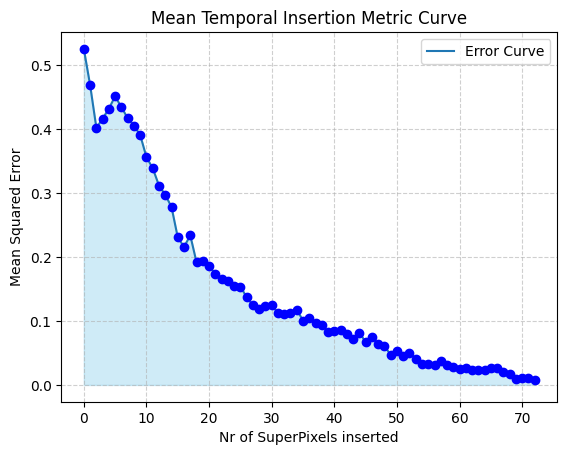

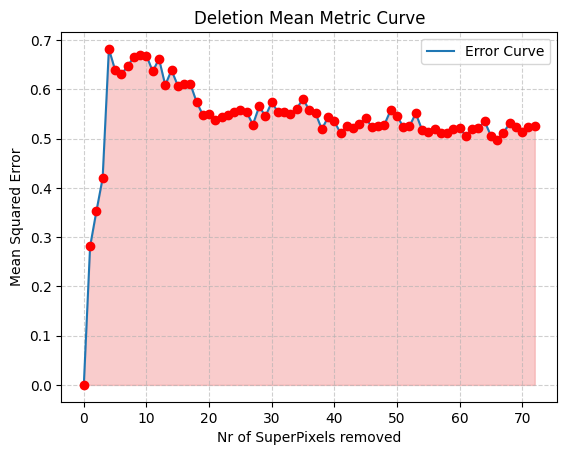

In [18]:
parameter_combinations = next(iter(lime_shap_st_results["lime"]))
print(parameter_combinations)

all_errors_insertion = lime_shap_st_results["lime"][parameter_combinations]["errors_insertion"]
all_errors_deletion  = lime_shap_st_results["lime"][parameter_combinations]["errors_deletion"]

plot_mean_insertion_curve(all_errors_insertion)
plot_mean_deletion_curve(all_errors_deletion)

In [41]:
import numpy as np
import matplotlib.pyplot as plt

def calculate_auc(x, y):
    """
    Calcola l'area sotto la curva (AUC) utilizzando il metodo del trapezio.

    :param x: Valori dell'asse x (frazione dei pixel/frame inseriti).
    :param y: Valori dell'asse y (errori calcolati).
    :return: Area sotto la curva.
    """
    return np.trapz(y, x)

def plot_combined_curves(all_errors_insertion, all_errors_deletion, parameter_combinations, title="",save_path=""):
    # Creazione della figura e dei due subplot (1 riga, 2 colonne)
    fig, axs = plt.subplots(1, 2, figsize=(12, 5))

    # Plot per la curva di inserimento
    max_len_insertion = max(map(len, all_errors_insertion))
    padded_array_insertion = np.full((len(all_errors_insertion), max_len_insertion), np.nan)
    for i, row in enumerate(all_errors_insertion):
        padded_array_insertion[i, :len(row)] = row  # Riempie solo le parti esistenti
    mean_errors_for_insertion_vott = np.nanmean(padded_array_insertion, axis=0)

    #x_insertion = np.arange(0, mean_errors_for_insertion_vott.shape[0])
    x_insertion = np.linspace(0, 1, mean_errors_for_insertion_vott.shape[0])
    auc_insertion = calculate_auc(x_insertion, mean_errors_for_insertion_vott)
    auc_text_insertion = f'AUC = {auc_insertion:.2f}'
    axs[0].plot(x_insertion, mean_errors_for_insertion_vott, label=f'Error Curve, {auc_text_insertion}')
    #axs[0].scatter(x_insertion, mean_errors_for_insertion_vott, color='blue', zorder=3)    
    

    axs[0].fill_between(x_insertion, mean_errors_for_insertion_vott, color='skyblue', alpha=0.4)
    axs[0].set_xlabel('Fraction of SuperPixels inserted')
    axs[0].set_ylabel('Mean Squared Error')
    axs[0].grid(True, linestyle='--', alpha=0.6)
    axs[0].set_title('Insertion Mean Curve')
    axs[0].legend()

    # Plot per la curva di cancellazione
    max_len_deletion = max(map(len, all_errors_deletion))
    padded_array_deletion = np.full((len(all_errors_deletion), max_len_deletion), np.nan)
    for i, row in enumerate(all_errors_deletion):
        padded_array_deletion[i, :len(row)] = row  # Riempie solo le parti esistenti
    mean_errors_for_deletion_vott = np.nanmean(padded_array_deletion, axis=0)
    #mean_errors_for_deletion_vott = np.nanmean(all_errors_deletion, axis=0)

    #x_deletion = np.arange(0, mean_errors_for_deletion_vott.shape[0])
    x_deletion = np.linspace(0, 1, mean_errors_for_deletion_vott.shape[0])
    auc_deletion = calculate_auc(x_deletion, mean_errors_for_deletion_vott)
    auc_text_deletion = f'AUC = {auc_deletion:.2f}'
    
    axs[1].plot(x_deletion, mean_errors_for_deletion_vott, label=f'Error Curve, {auc_text_deletion}')
    #axs[1].scatter(x_deletion, mean_errors_for_deletion_vott, color='red', zorder=3)
    axs[1].fill_between(x_deletion, mean_errors_for_deletion_vott, color='lightcoral', alpha=0.4)
    axs[1].set_xlabel('Fraction of SuperPixels removed')
    axs[1].set_ylabel('Mean Squared Error')
    axs[1].grid(True, linestyle='--', alpha=0.6)
    axs[1].set_title('Deletion Mean Curve')
    axs[1].legend()

    # Aggiungi il titolo globale
    plt.suptitle(title, fontsize=16)
    # Mostra i plot
    plt.tight_layout()

    # Salva la figura con DPI 400
    #plt.tight_layout()
    #plt.subplots_adjust(top=0.85)  # Per evitare che il titolo si sovrapponga ai grafici
    #plt.savefig(save_path, dpi=400)

    plt.show()

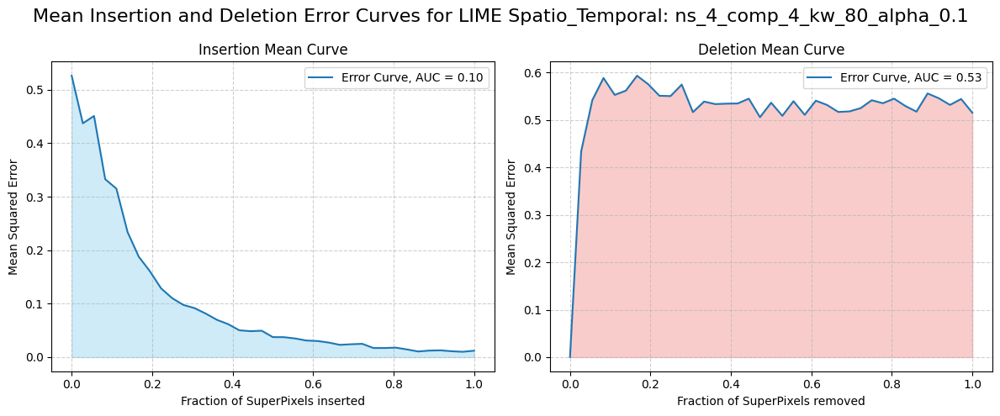

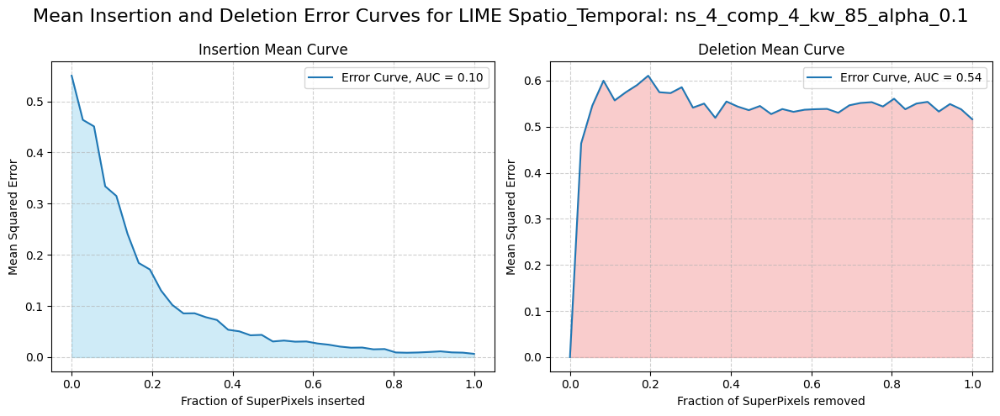

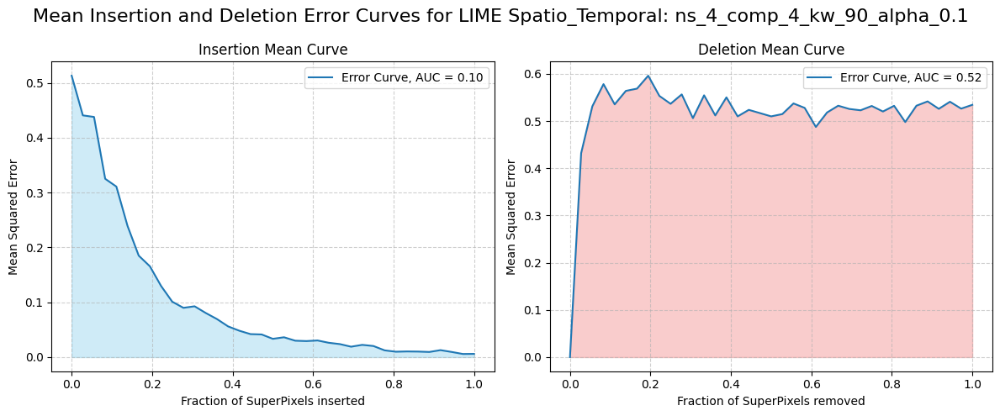

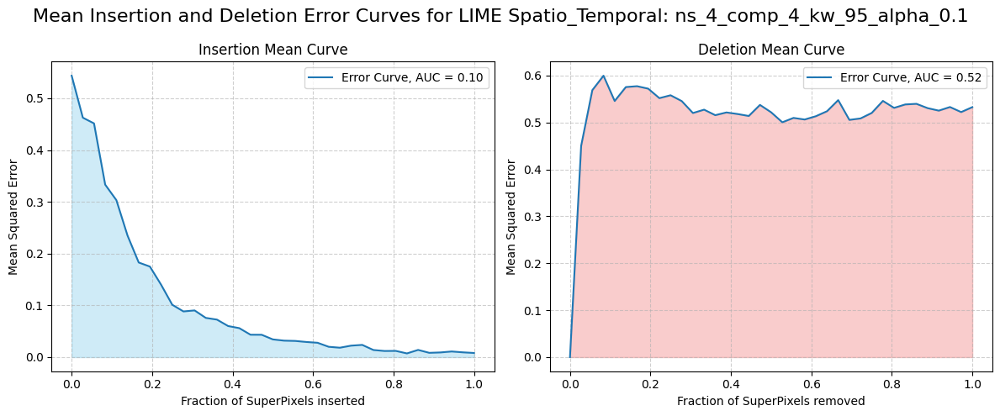

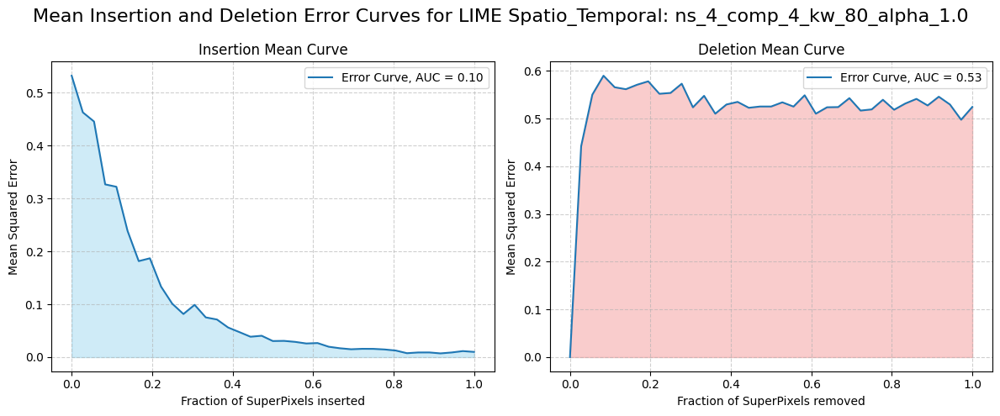

...

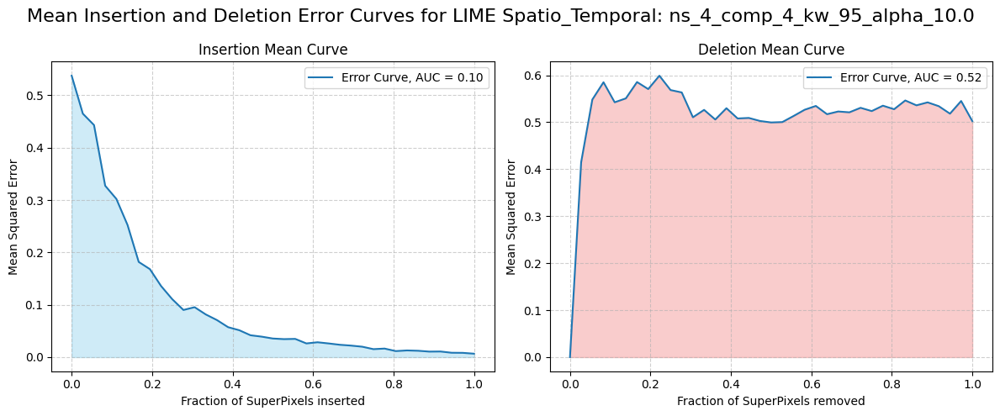

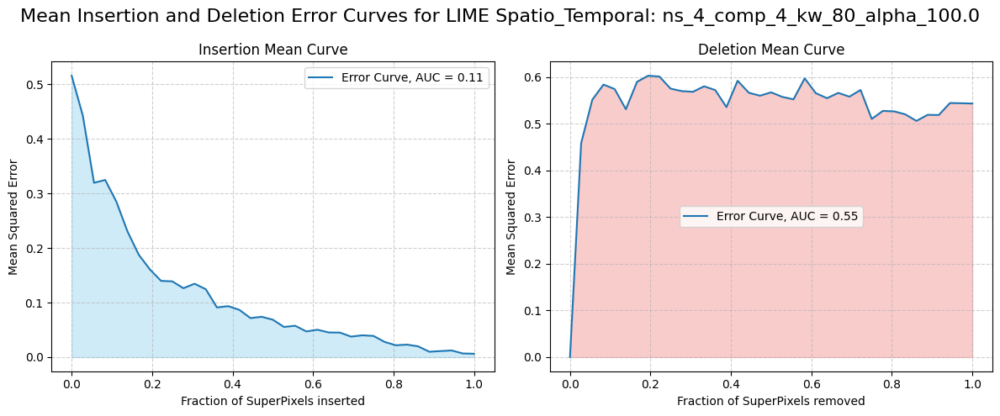

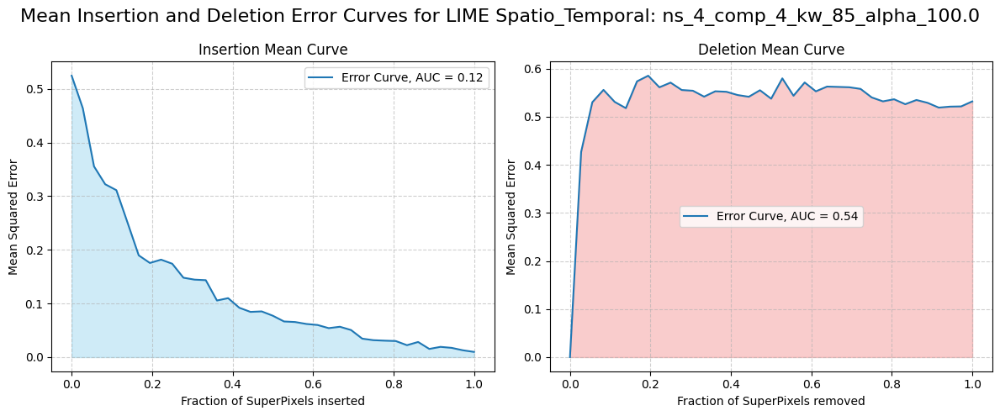

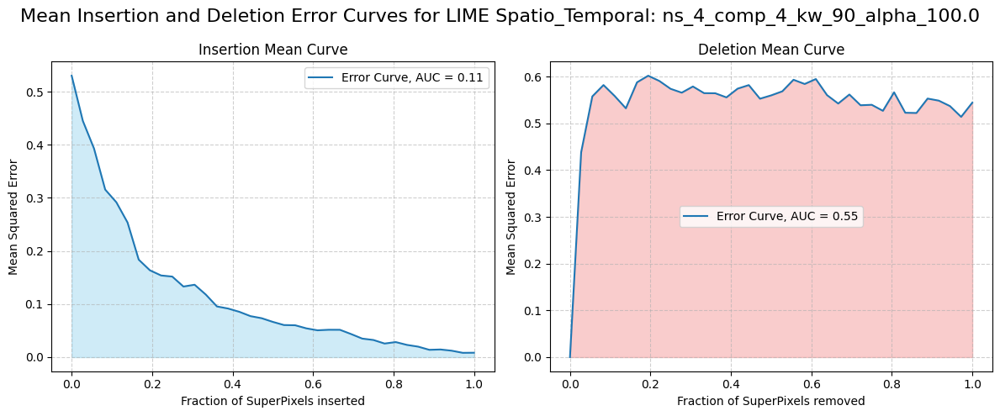

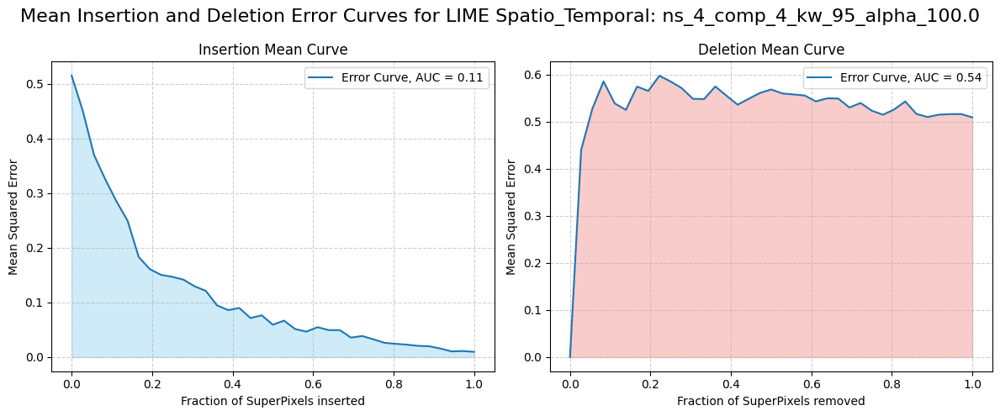

In [28]:
import pickle

n_segments  = 4
compactness = 4

#results_setups_path = "./MyDrive/Water_Resources/wr_extensions/superpixels_versions/LIME/last_try/Temporal/results/lime_temporal_insertion_deletion_results_setup_kw_80_alpha_0.pkl"
path_to_load_results = os.path.join(work_path, "Water_Resources/rise-video/XAI/spatial_temporal/results/lime_shap_multiplicative_norm_zero/")
results_string_name  = f"lime_shap_st_results_setup_ns_{n_segments}_comp_{compactness}.pkl"

# Apri il file in modalità lettura binaria ('rb')
with open(path_to_load_results + results_string_name, 'rb') as file:
    lime_shap_st_results = pickle.load(file)

for parameter_combination in lime_shap_st_results["lime"]:
    all_errors_insertion = lime_shap_st_results["lime"][parameter_combination]["errors_insertion"]
    all_errors_deletion  = lime_shap_st_results["lime"][parameter_combination]["errors_deletion"]

    plot_combined_curves(all_errors_insertion, all_errors_deletion, parameter_combination)

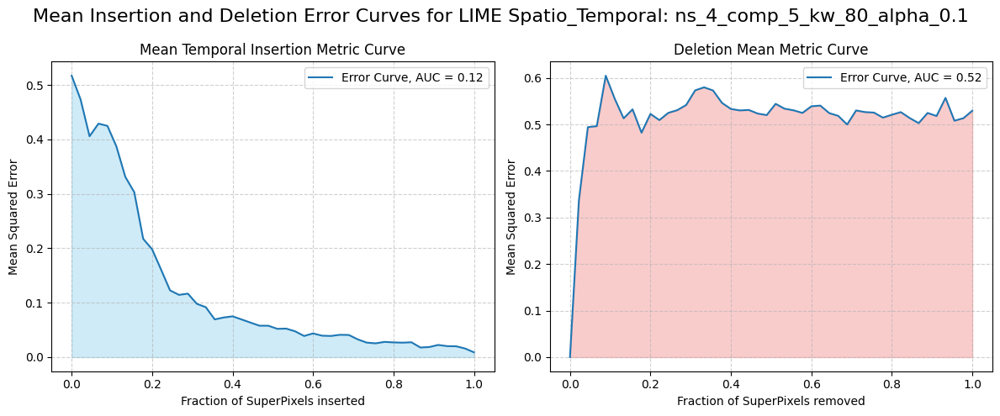

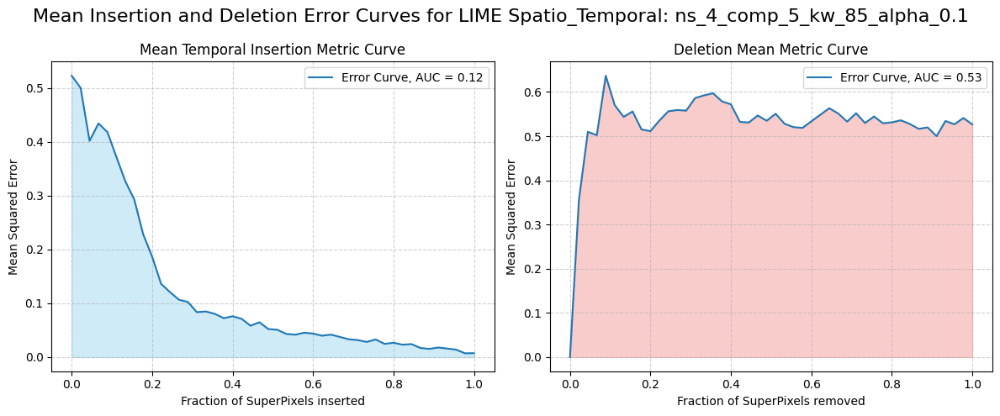

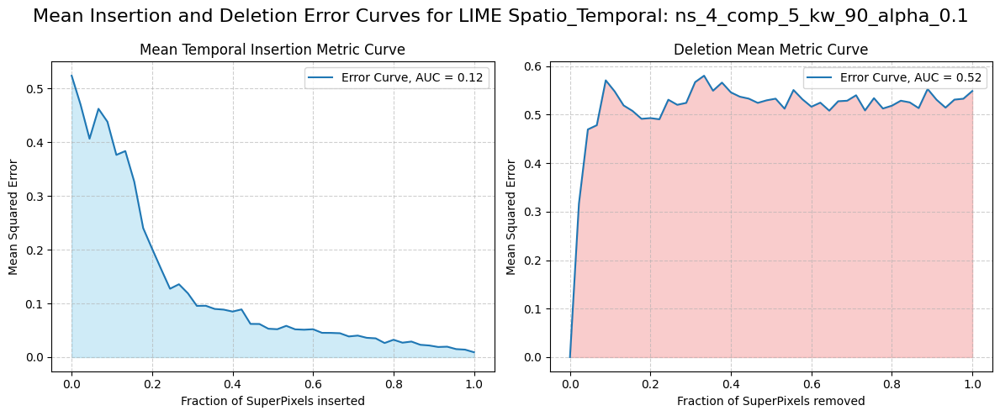

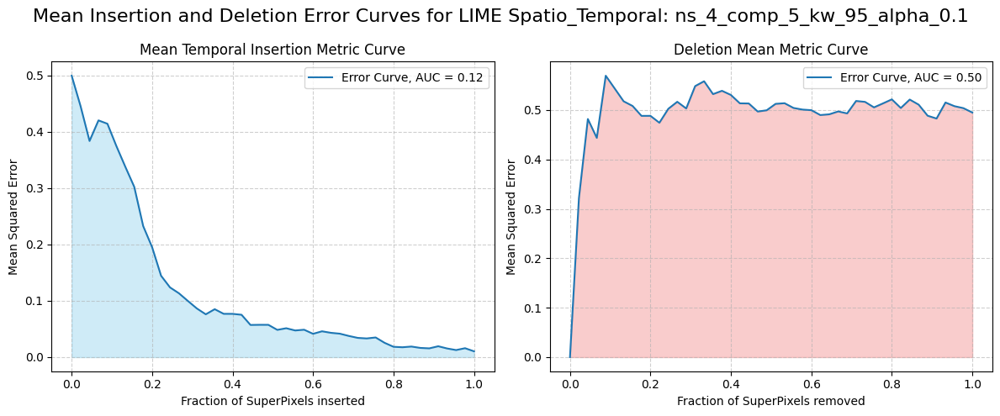

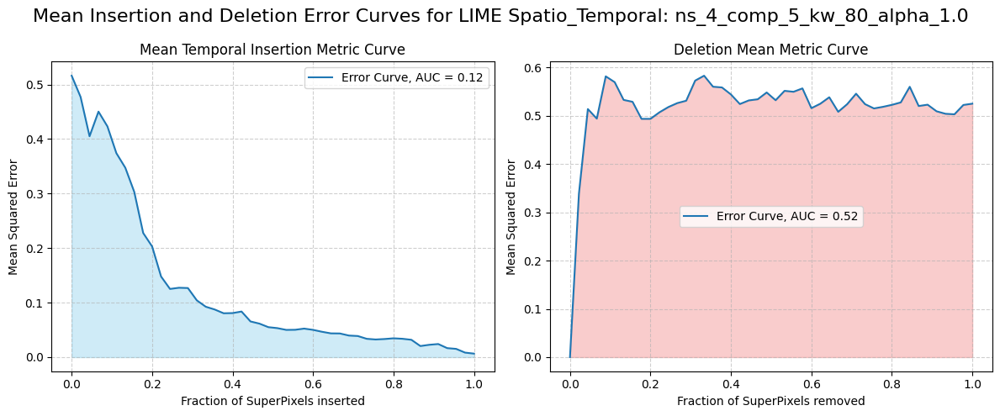

...

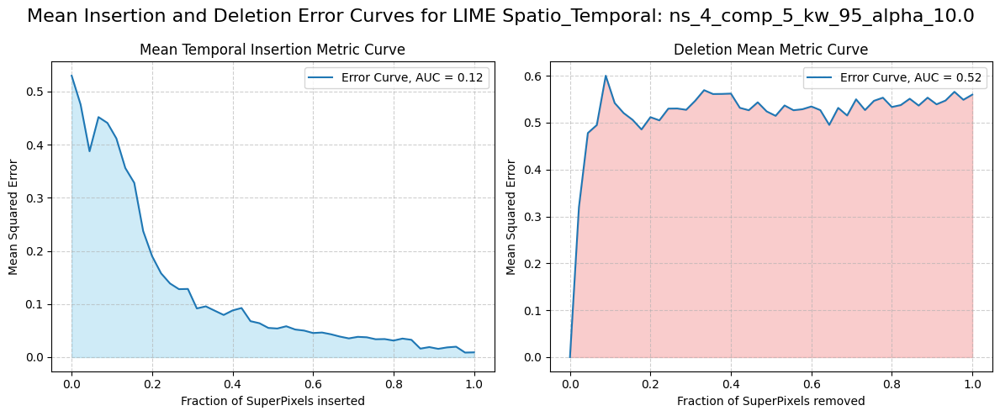

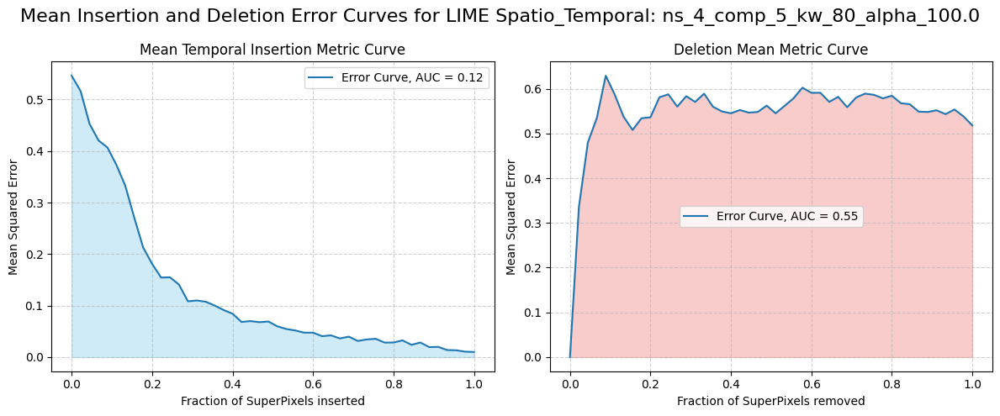

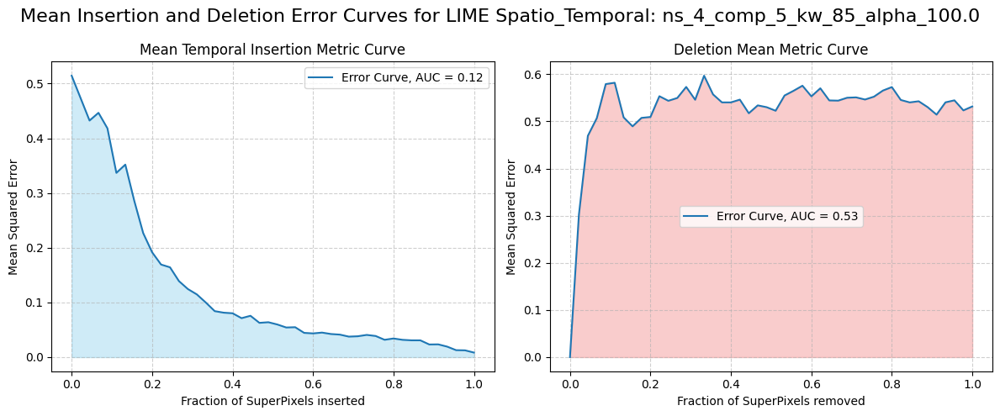

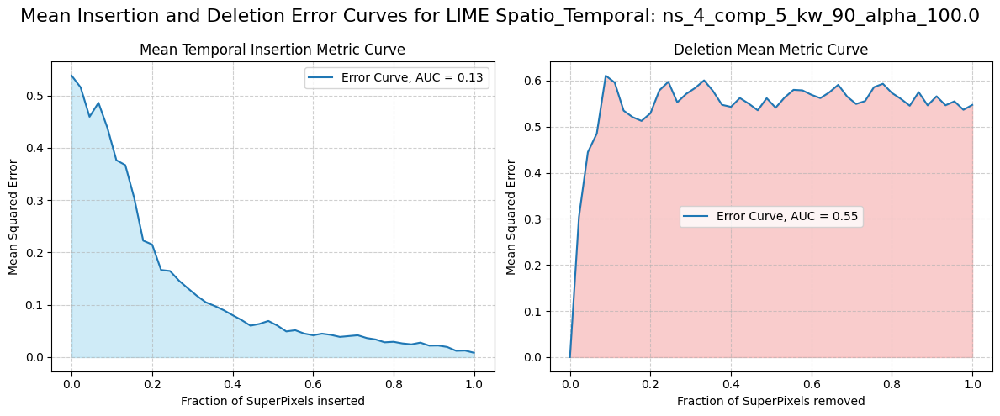

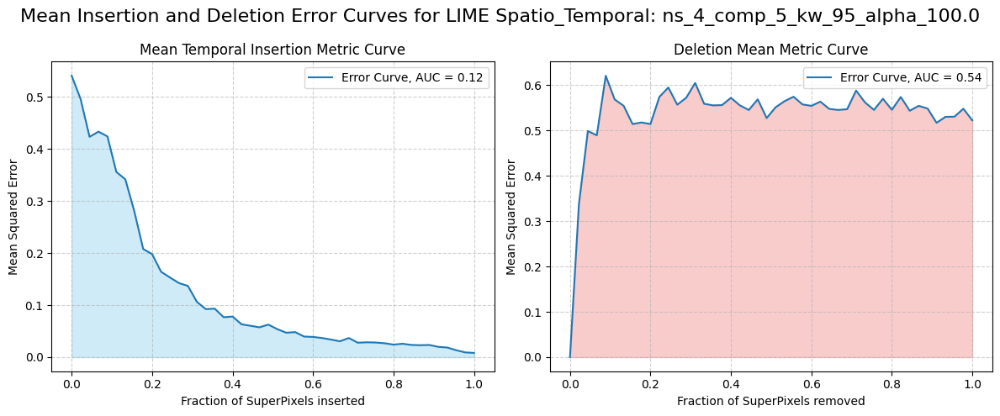

In [25]:
import pickle

n_segments  = 4
compactness = 5

#results_setups_path = "./MyDrive/Water_Resources/wr_extensions/superpixels_versions/LIME/last_try/Temporal/results/lime_temporal_insertion_deletion_results_setup_kw_80_alpha_0.pkl"
path_to_load_results = os.path.join(work_path, "Water_Resources/rise-video/XAI/spatial_temporal/results/lime_shap_multiplicative_norm_zero/")
results_string_name  = f"lime_shap_st_results_setup_ns_{n_segments}_comp_{compactness}.pkl"

# Apri il file in modalità lettura binaria ('rb')
with open(path_to_load_results + results_string_name, 'rb') as file:
    lime_shap_st_results = pickle.load(file)

for parameter_combination in lime_shap_st_results["lime"]:
    all_errors_insertion = lime_shap_st_results["lime"][parameter_combination]["errors_insertion"]
    all_errors_deletion  = lime_shap_st_results["lime"][parameter_combination]["errors_deletion"]

    plot_combined_curves(all_errors_insertion, all_errors_deletion, parameter_combination)

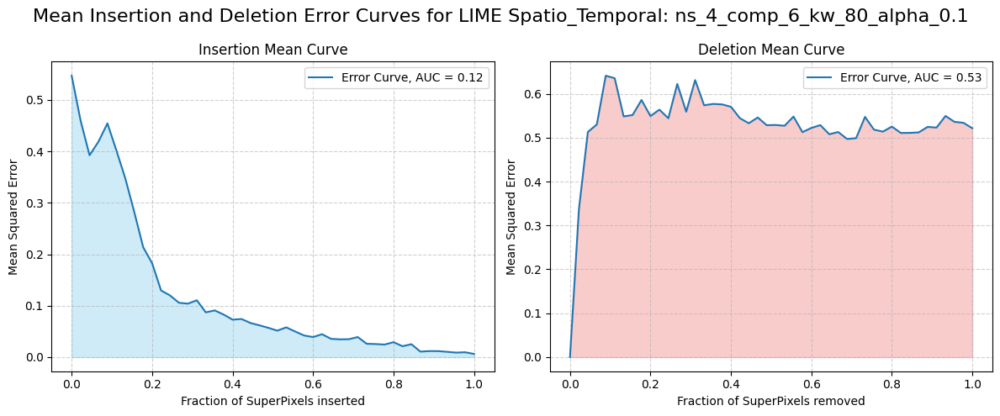

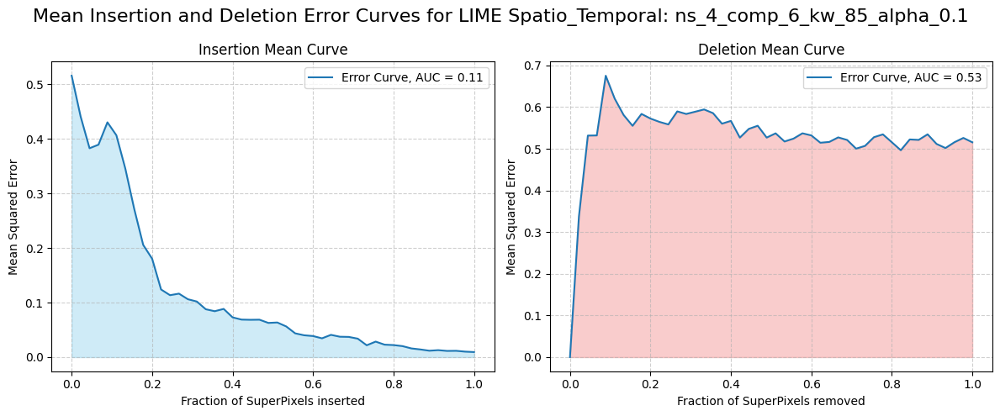

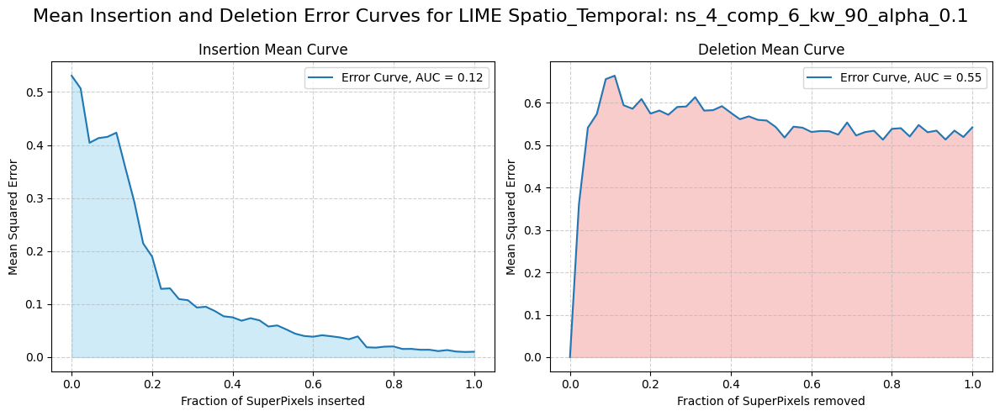

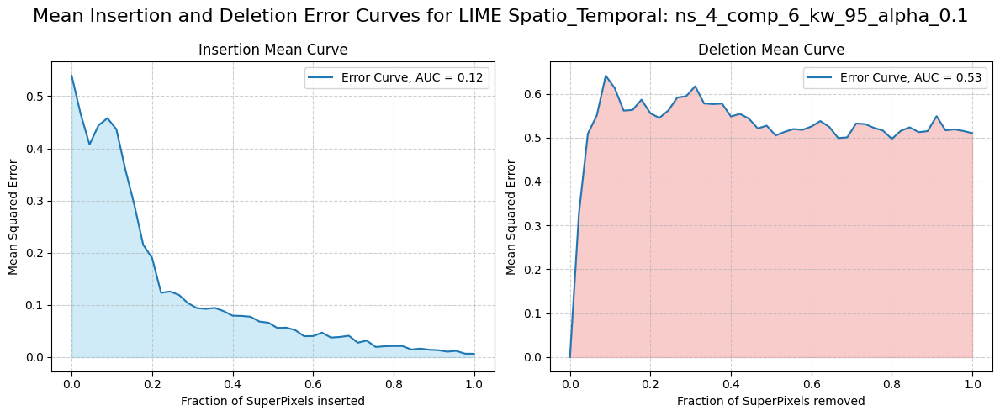

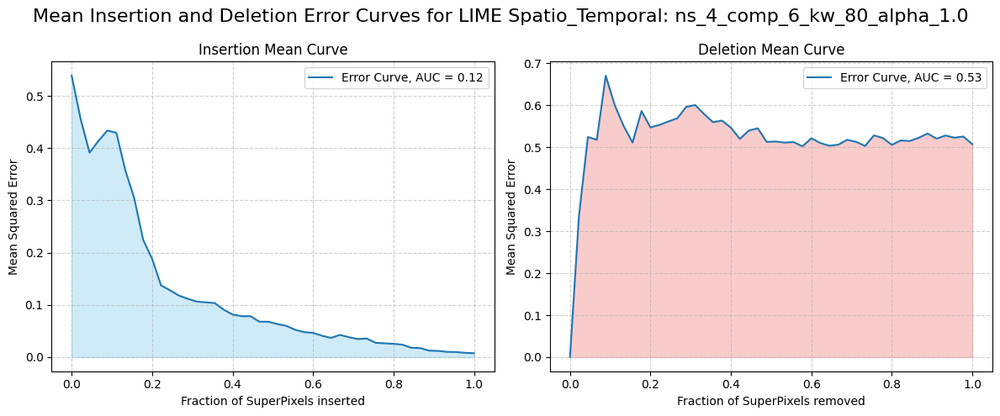

...

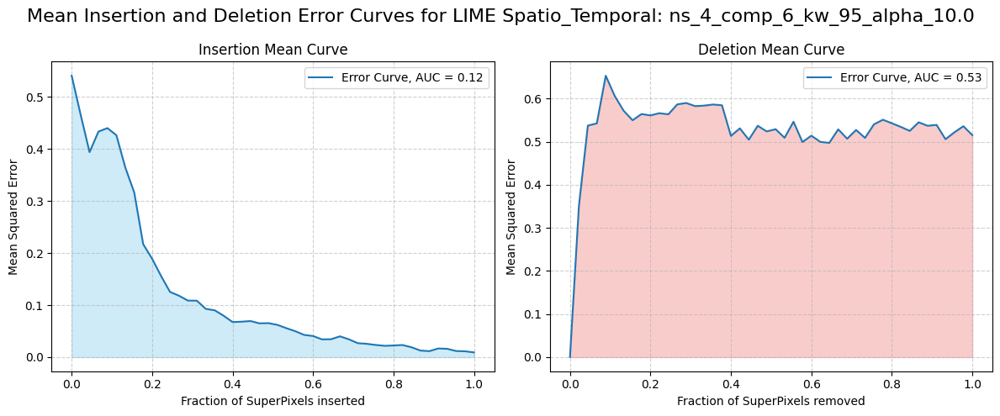

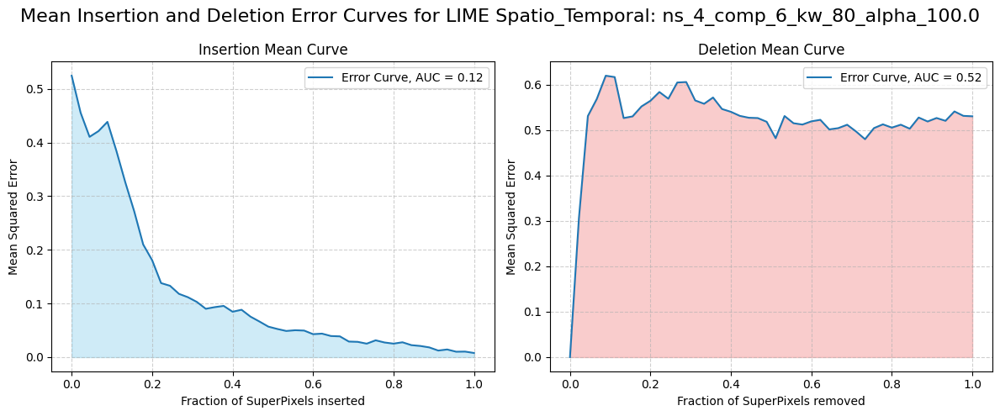

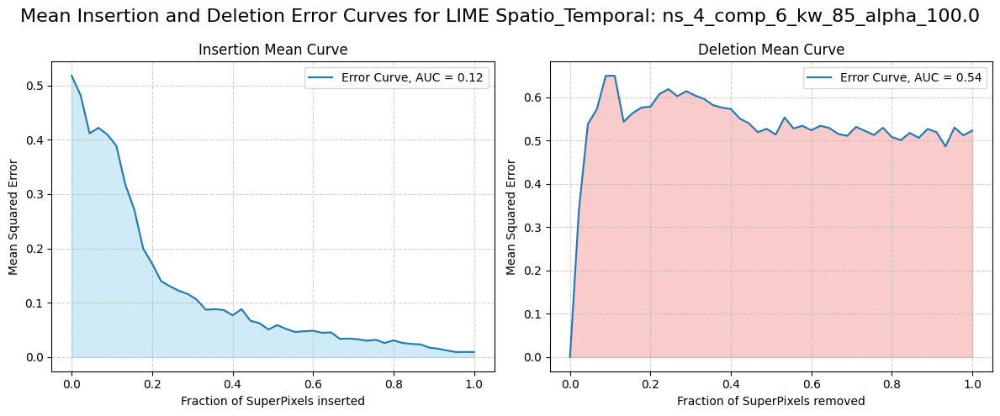

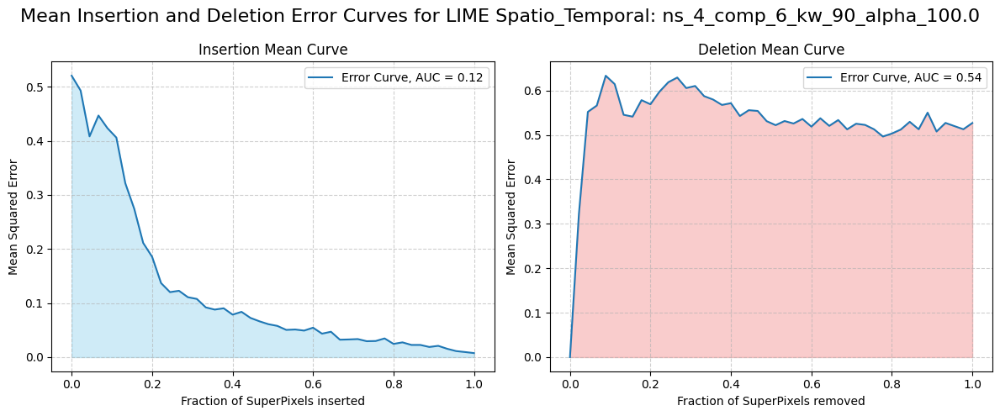

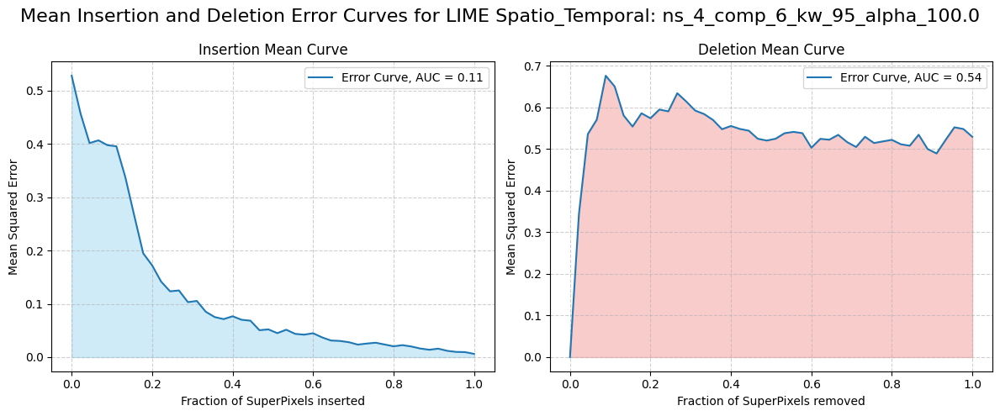

In [29]:
import pickle

n_segments  = 4
compactness = 6

#results_setups_path = "./MyDrive/Water_Resources/wr_extensions/superpixels_versions/LIME/last_try/Temporal/results/lime_temporal_insertion_deletion_results_setup_kw_80_alpha_0.pkl"
path_to_load_results = os.path.join(work_path, "Water_Resources/rise-video/XAI/spatial_temporal/results/lime_shap_multiplicative_norm_zero/")
results_string_name  = f"lime_shap_st_results_setup_ns_{n_segments}_comp_{compactness}.pkl"

# Apri il file in modalità lettura binaria ('rb')
with open(path_to_load_results + results_string_name, 'rb') as file:
    lime_shap_st_results = pickle.load(file)

for parameter_combination in lime_shap_st_results["lime"]:
    all_errors_insertion = lime_shap_st_results["lime"][parameter_combination]["errors_insertion"]
    all_errors_deletion  = lime_shap_st_results["lime"][parameter_combination]["errors_deletion"]

    plot_combined_curves(all_errors_insertion, all_errors_deletion, parameter_combination)

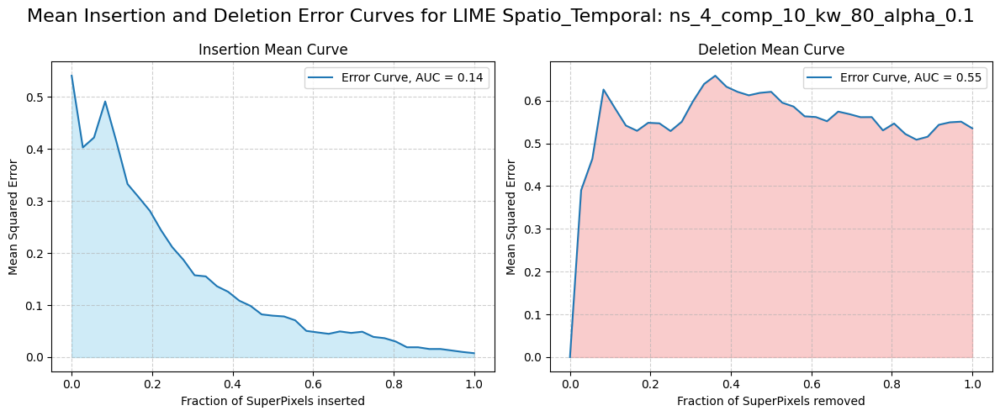

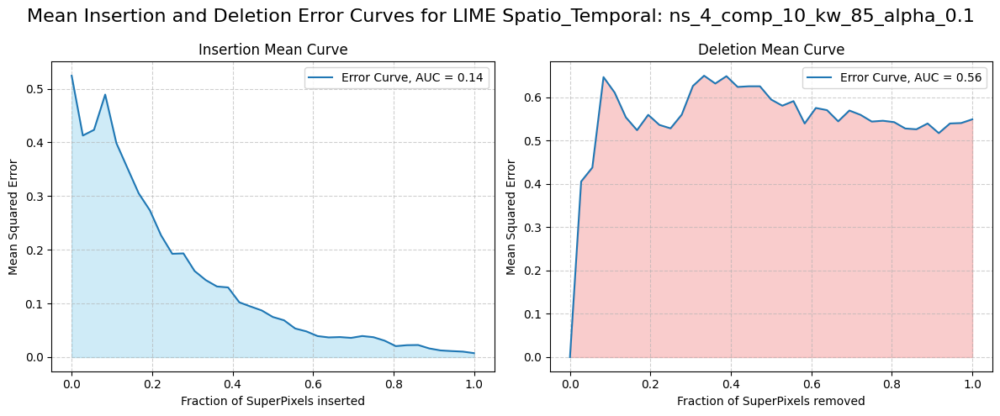

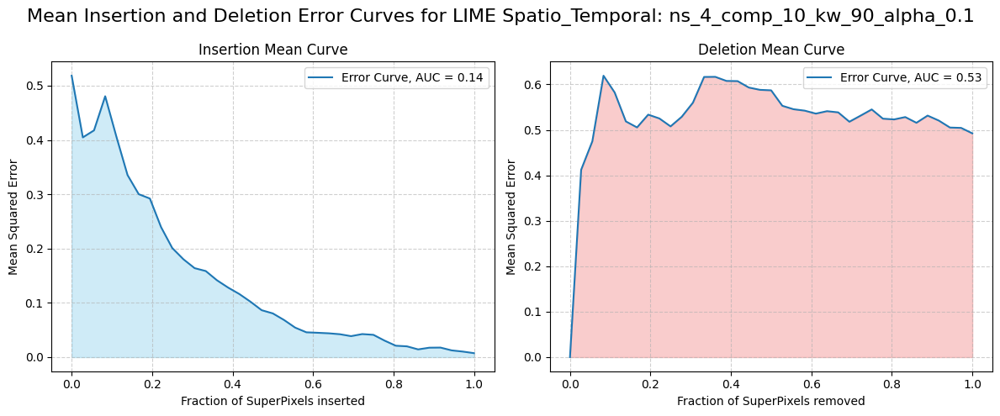

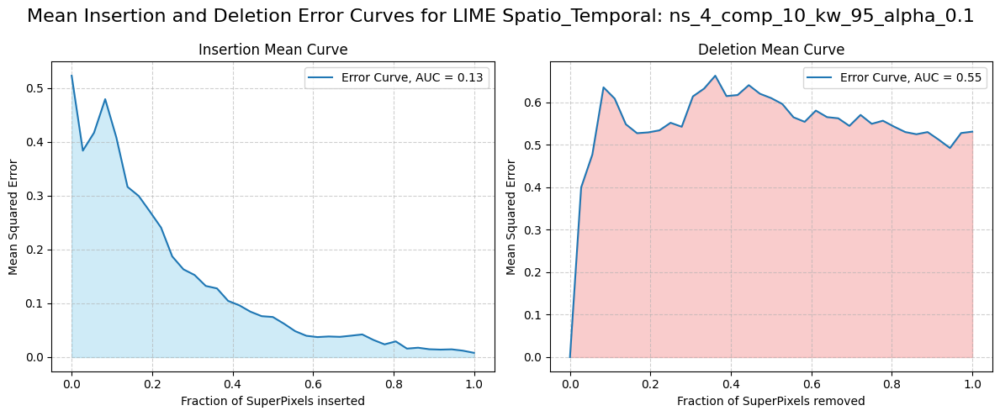

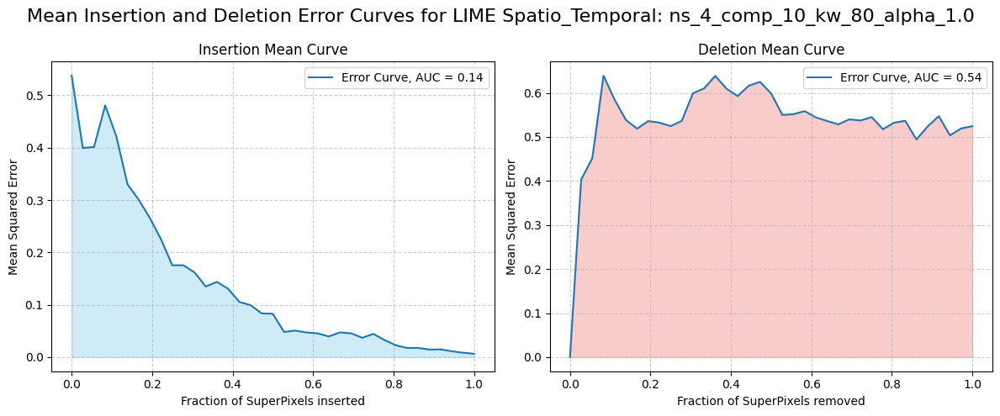

...

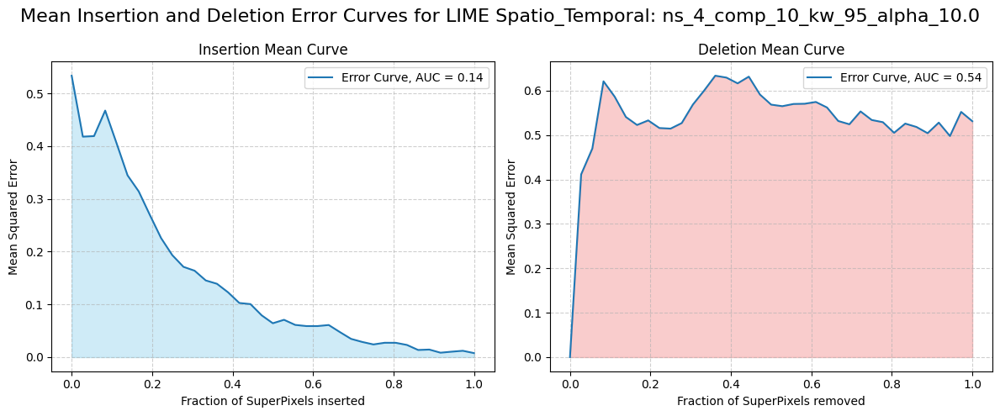

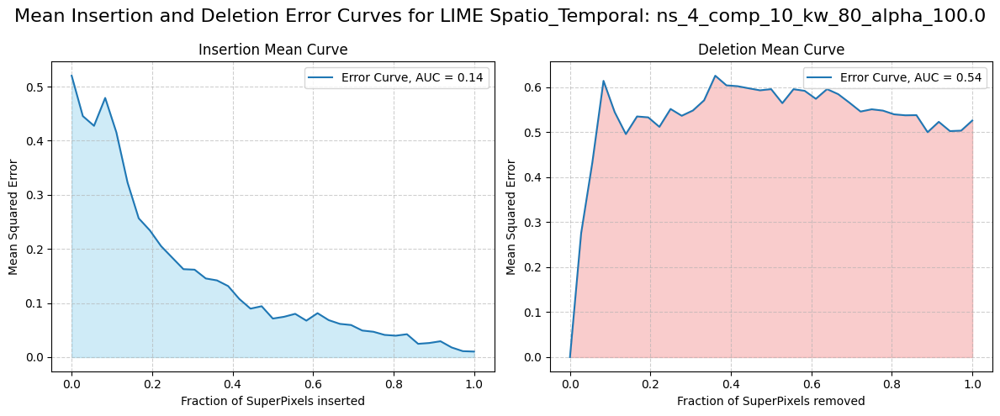

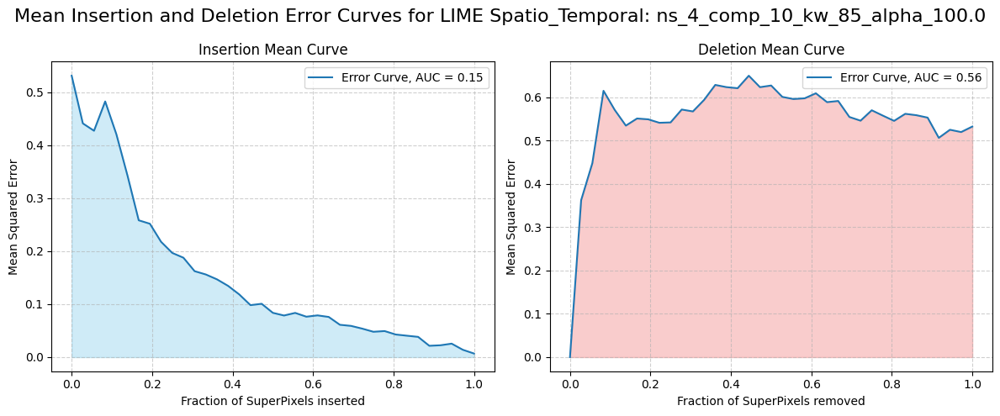

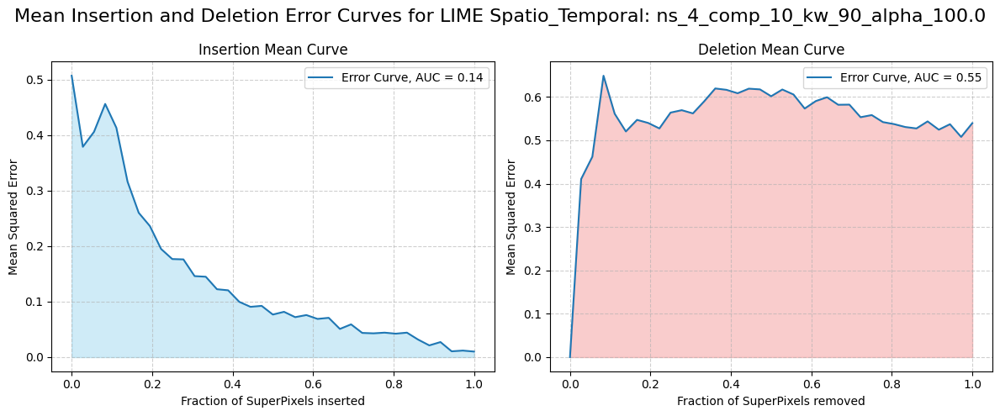

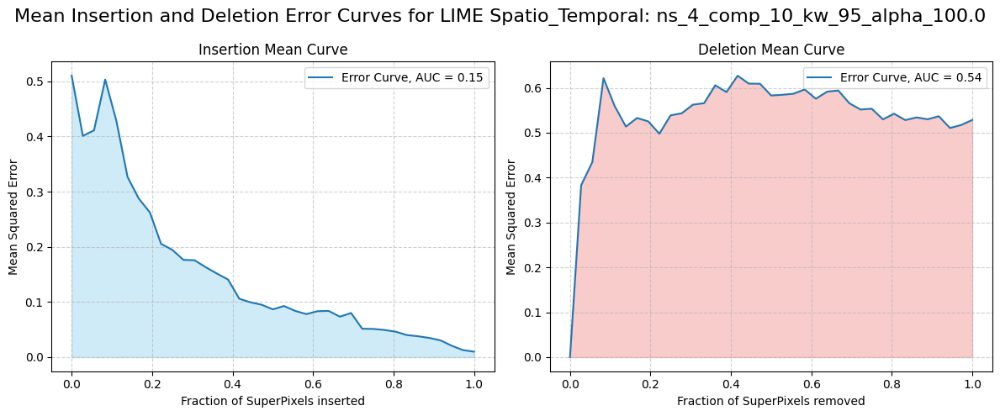

In [30]:
import pickle

n_segments  = 4
compactness = 10

#results_setups_path = "./MyDrive/Water_Resources/wr_extensions/superpixels_versions/LIME/last_try/Temporal/results/lime_temporal_insertion_deletion_results_setup_kw_80_alpha_0.pkl"
path_to_load_results = os.path.join(work_path, "Water_Resources/rise-video/XAI/spatial_temporal/results/lime_shap_multiplicative_norm_zero/")
results_string_name  = f"lime_shap_st_results_setup_ns_{n_segments}_comp_{compactness}.pkl"

# Apri il file in modalità lettura binaria ('rb')
with open(path_to_load_results + results_string_name, 'rb') as file:
    lime_shap_st_results = pickle.load(file)

for parameter_combination in lime_shap_st_results["lime"]:
    all_errors_insertion = lime_shap_st_results["lime"][parameter_combination]["errors_insertion"]
    all_errors_deletion  = lime_shap_st_results["lime"][parameter_combination]["errors_deletion"]

    plot_combined_curves(all_errors_insertion, all_errors_deletion, parameter_combination)

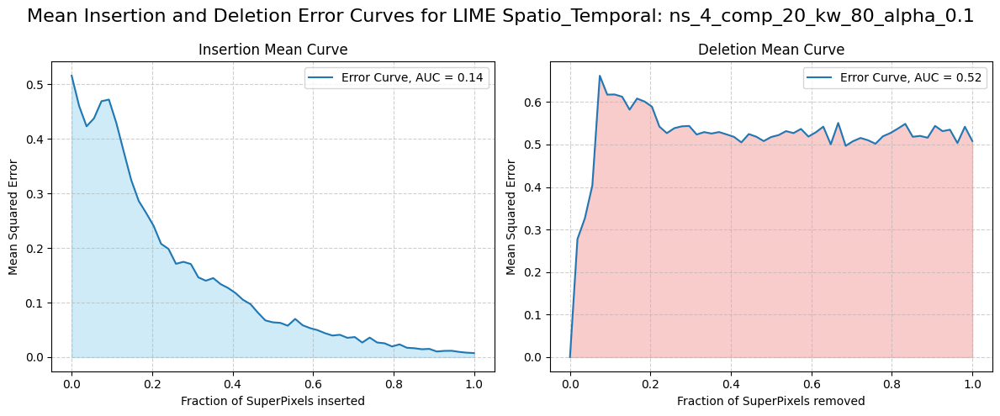

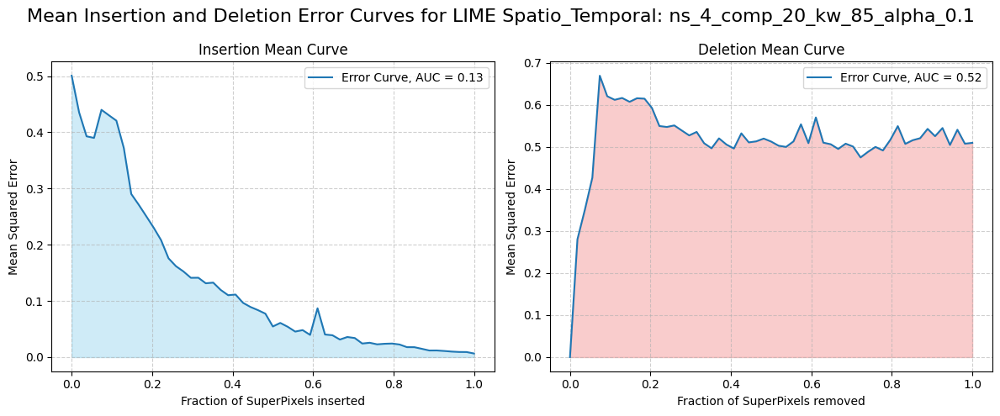

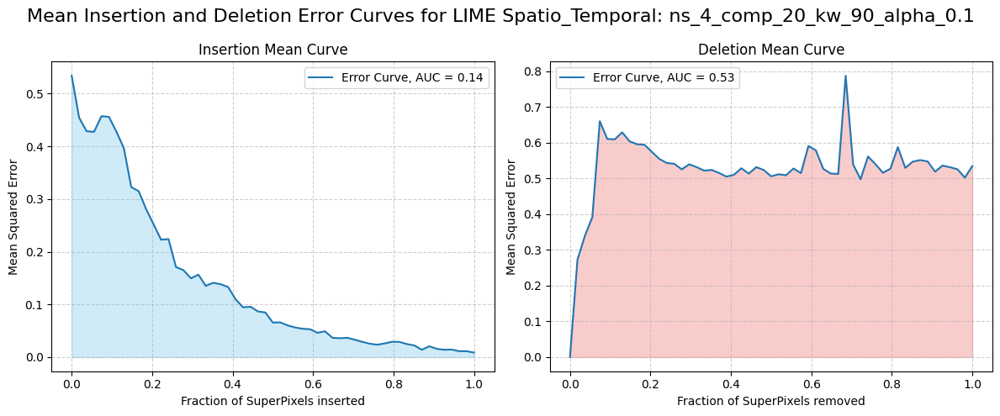

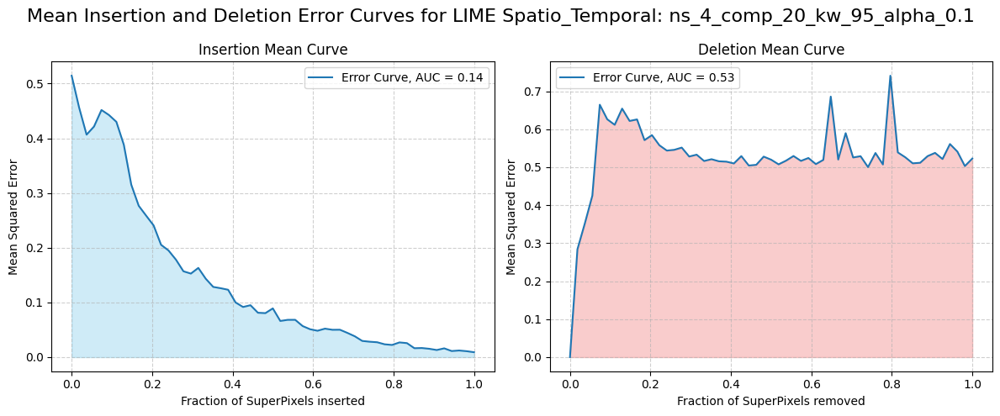

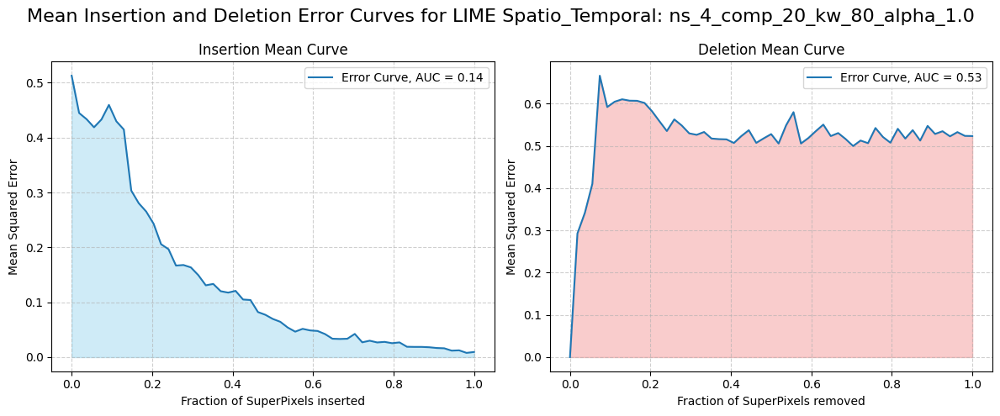

...

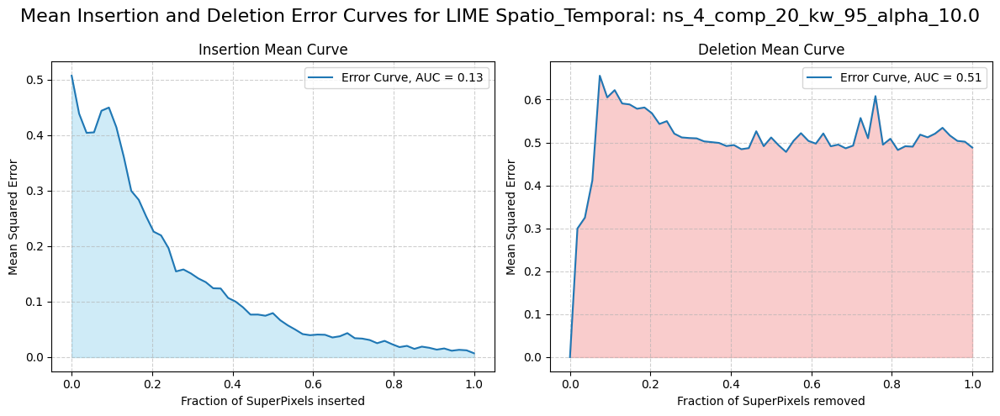

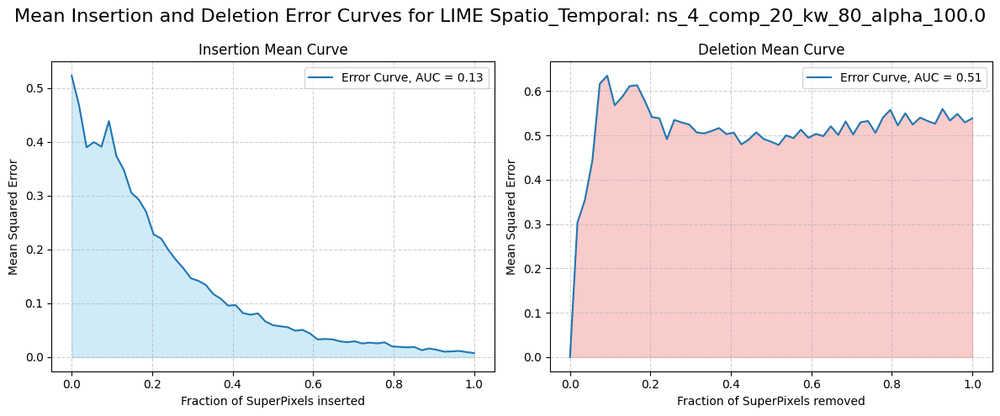

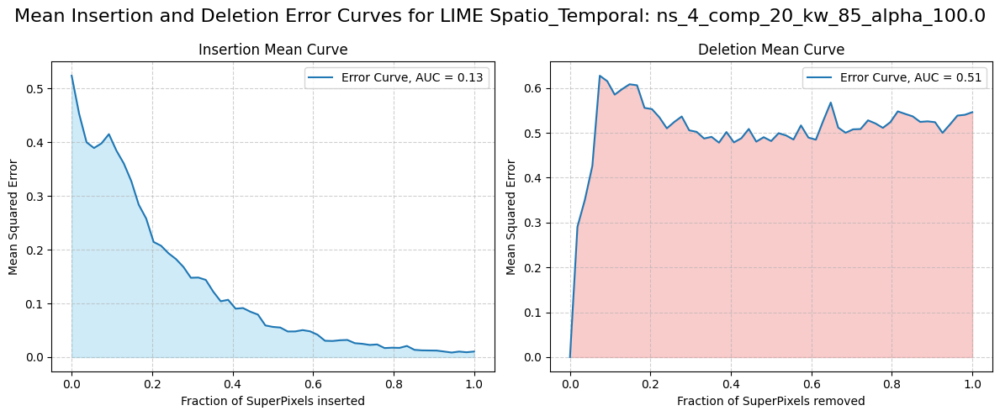

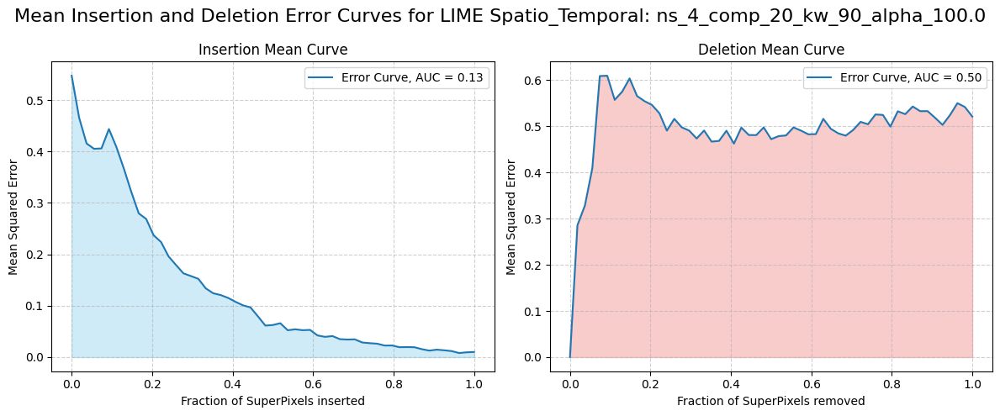

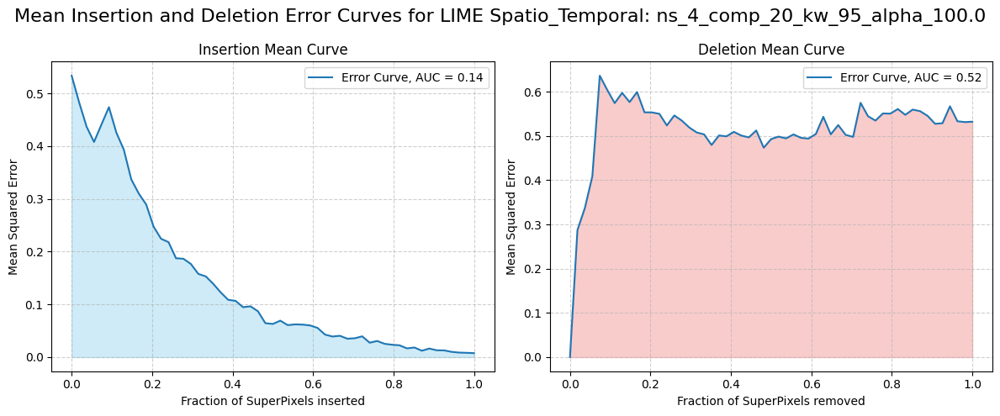

In [31]:
import pickle

n_segments  = 4
compactness = 20

#results_setups_path = "./MyDrive/Water_Resources/wr_extensions/superpixels_versions/LIME/last_try/Temporal/results/lime_temporal_insertion_deletion_results_setup_kw_80_alpha_0.pkl"
path_to_load_results = os.path.join(work_path, "Water_Resources/rise-video/XAI/spatial_temporal/results/lime_shap_multiplicative_norm_zero/")
results_string_name  = f"lime_shap_st_results_setup_ns_{n_segments}_comp_{compactness}.pkl"

# Apri il file in modalità lettura binaria ('rb')
with open(path_to_load_results + results_string_name, 'rb') as file:
    lime_shap_st_results = pickle.load(file)

for parameter_combination in lime_shap_st_results["lime"]:
    all_errors_insertion = lime_shap_st_results["lime"][parameter_combination]["errors_insertion"]
    all_errors_deletion  = lime_shap_st_results["lime"][parameter_combination]["errors_deletion"]

    plot_combined_curves(all_errors_insertion, all_errors_deletion, parameter_combination)

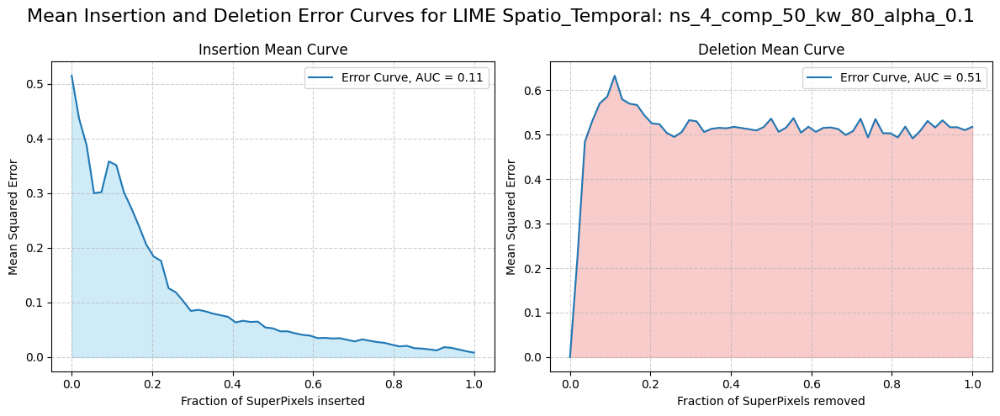

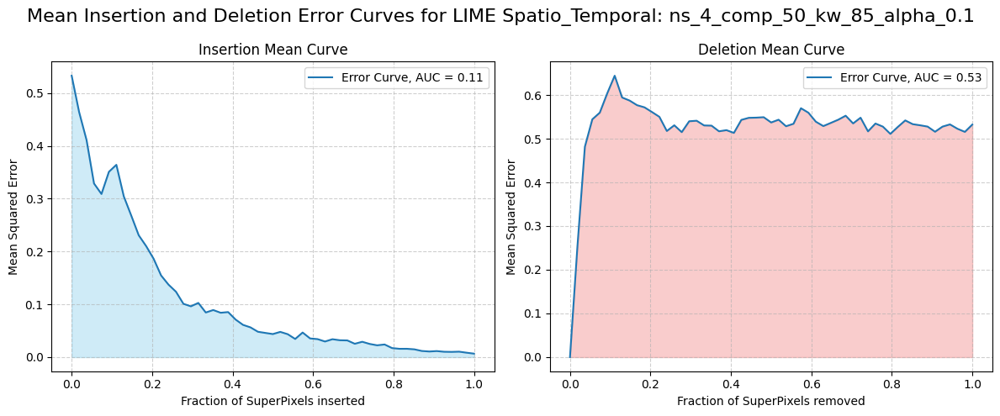

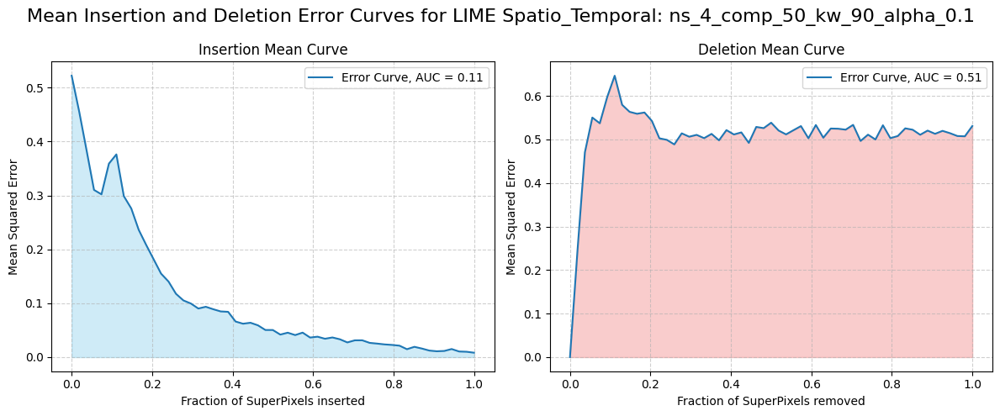

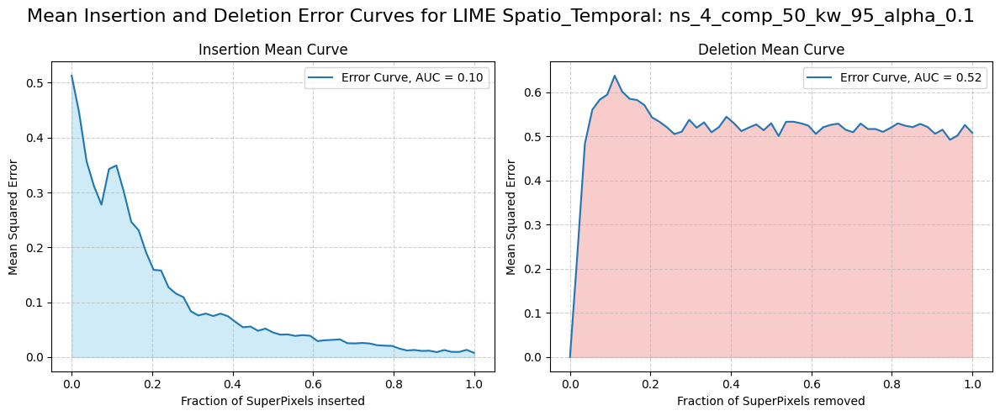

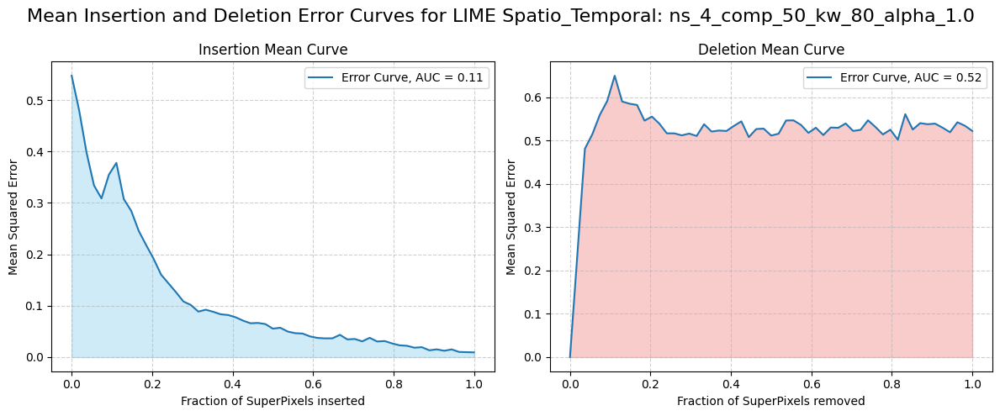

...

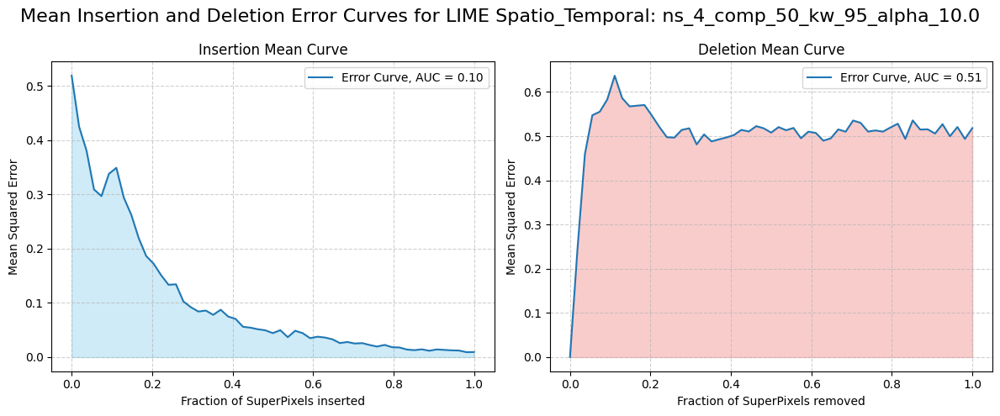

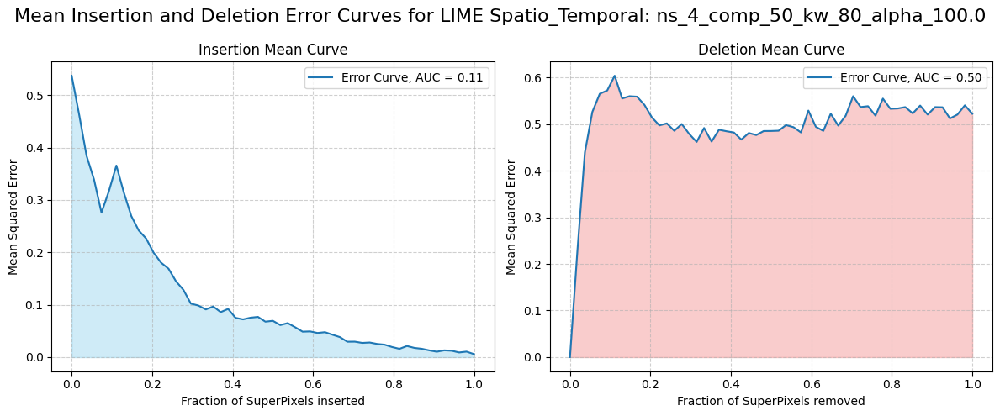

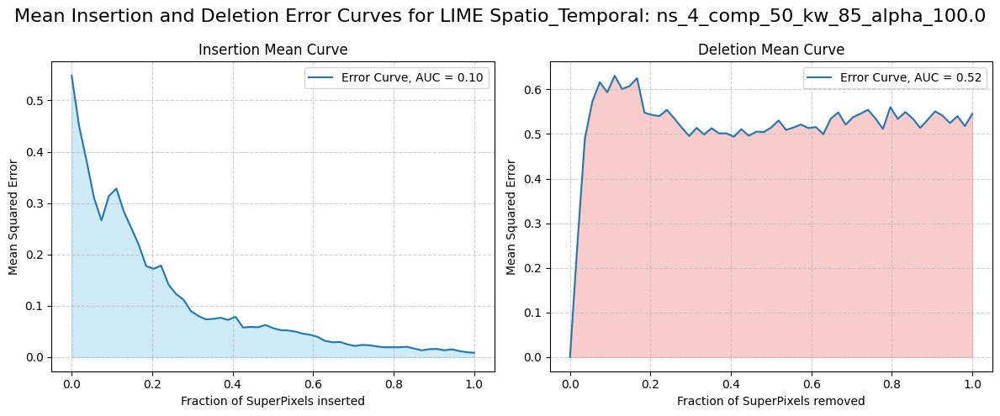

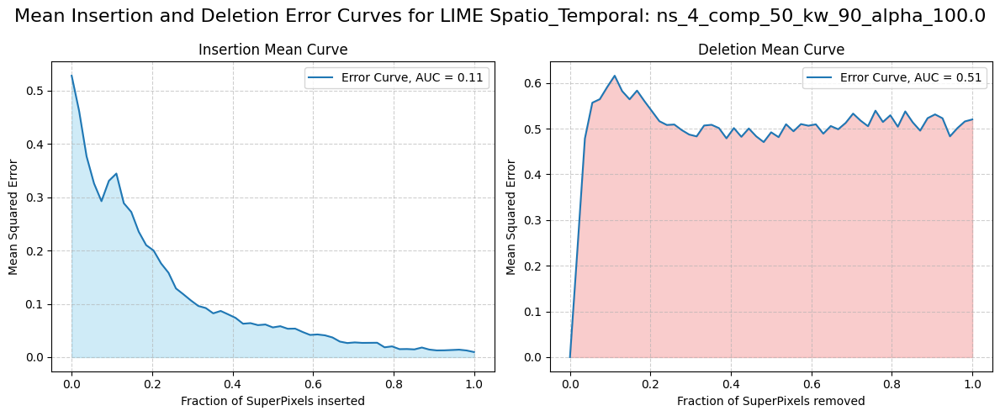

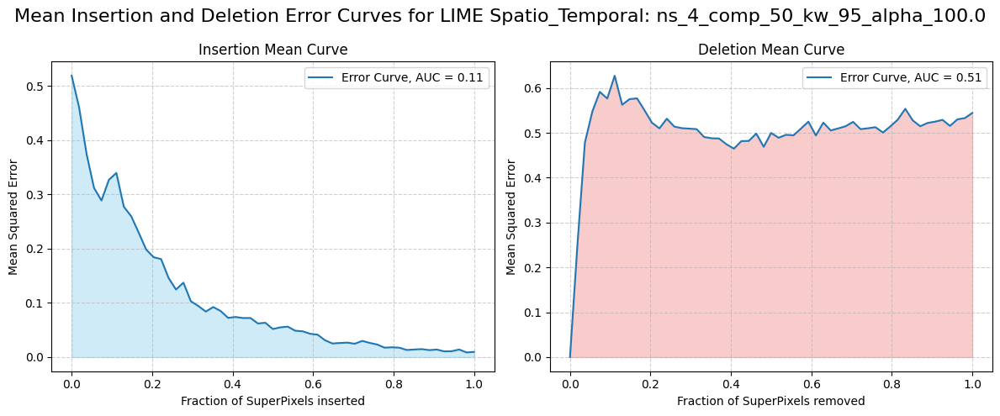

In [32]:
import pickle

n_segments  = 4
compactness = 50

#results_setups_path = "./MyDrive/Water_Resources/wr_extensions/superpixels_versions/LIME/last_try/Temporal/results/lime_temporal_insertion_deletion_results_setup_kw_80_alpha_0.pkl"
path_to_load_results = os.path.join(work_path, "Water_Resources/rise-video/XAI/spatial_temporal/results/lime_shap_multiplicative_norm_zero/")
results_string_name  = f"lime_shap_st_results_setup_ns_{n_segments}_comp_{compactness}.pkl"

# Apri il file in modalità lettura binaria ('rb')
with open(path_to_load_results + results_string_name, 'rb') as file:
    lime_shap_st_results = pickle.load(file)

for parameter_combination in lime_shap_st_results["lime"]:
    all_errors_insertion = lime_shap_st_results["lime"][parameter_combination]["errors_insertion"]
    all_errors_deletion  = lime_shap_st_results["lime"][parameter_combination]["errors_deletion"]

    plot_combined_curves(all_errors_insertion, all_errors_deletion, parameter_combination)

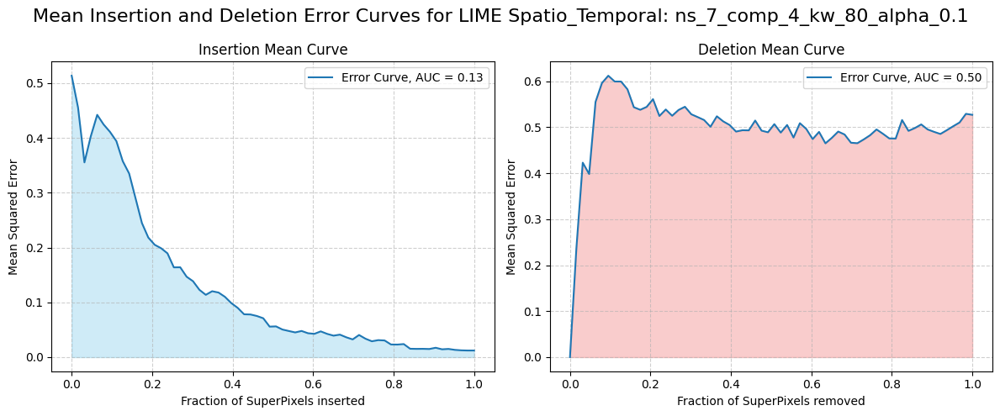

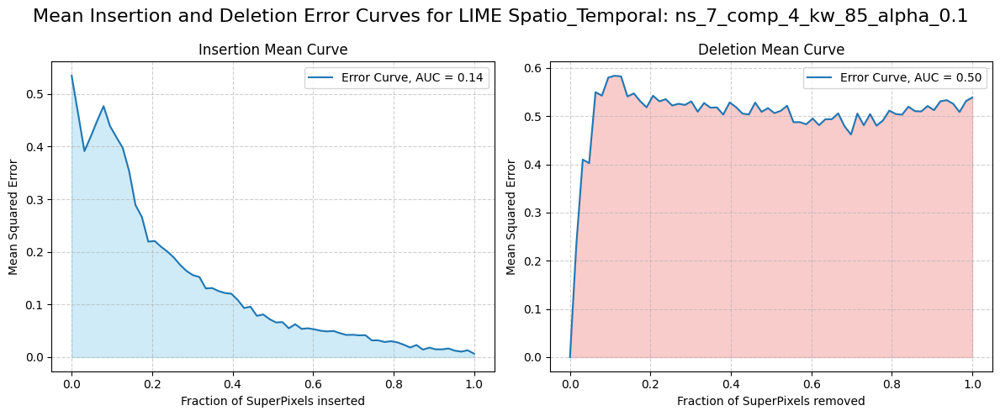

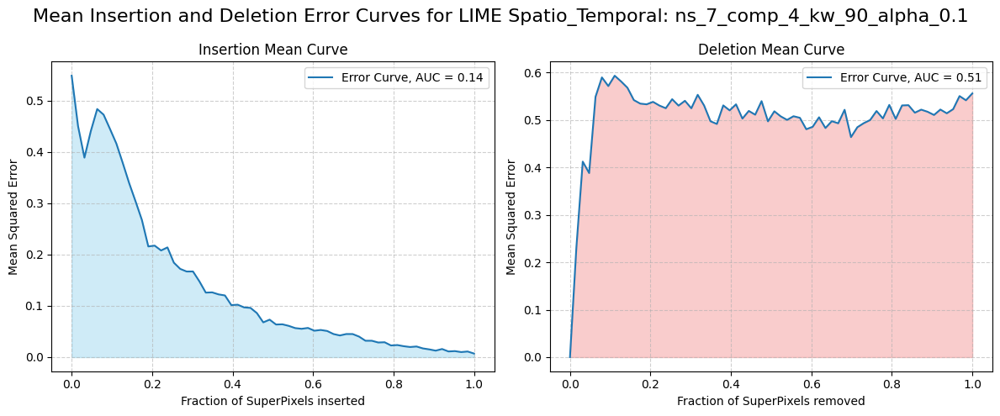

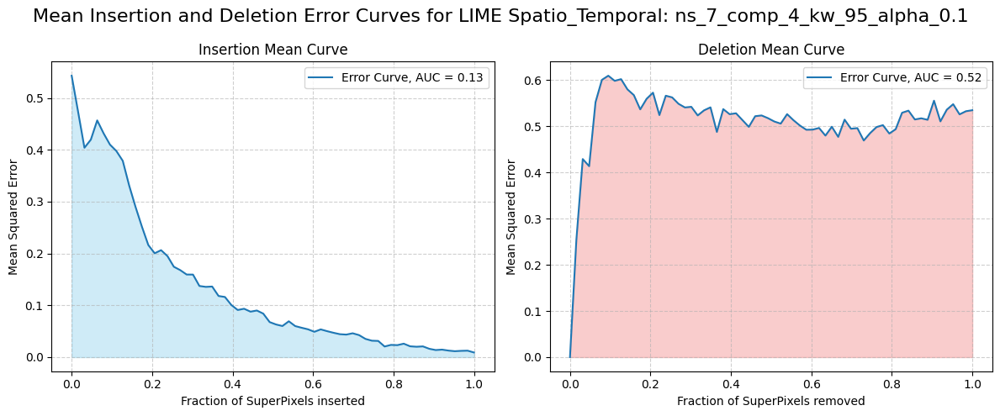

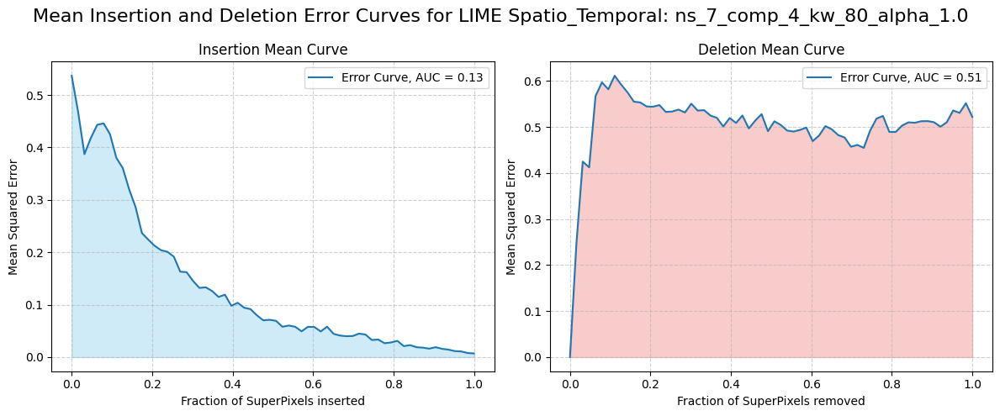

...

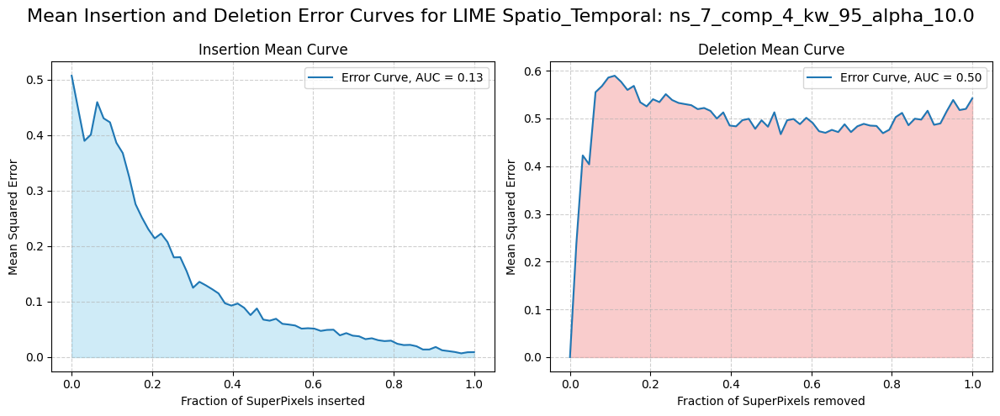

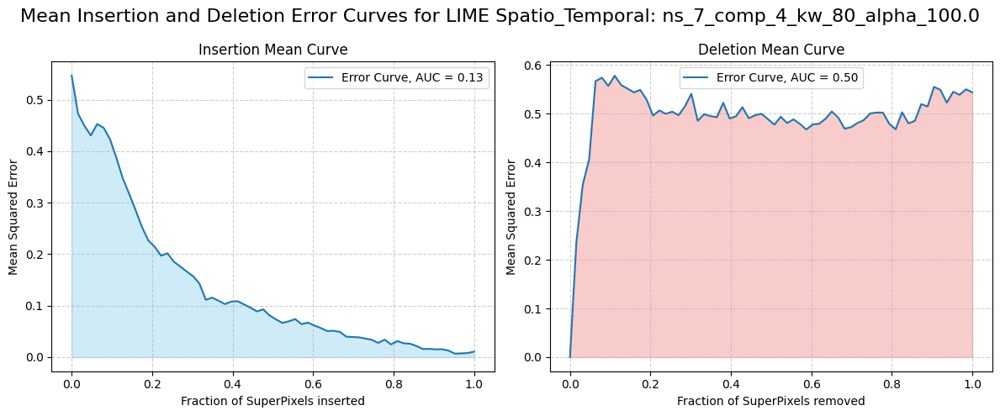

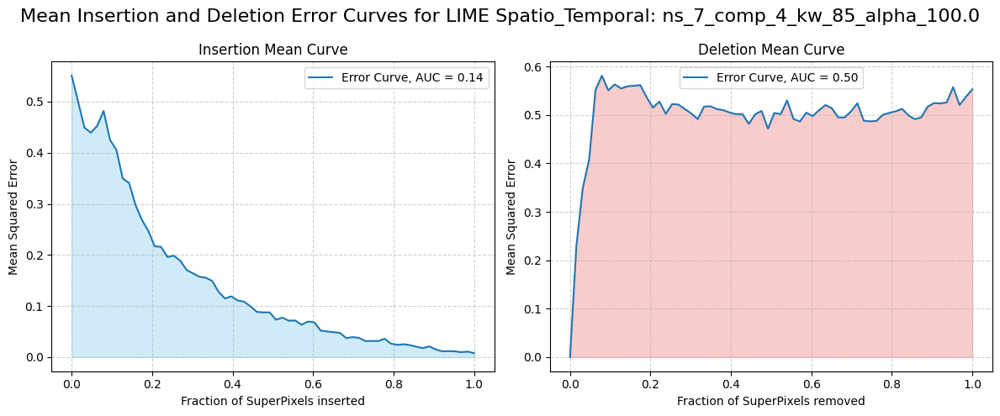

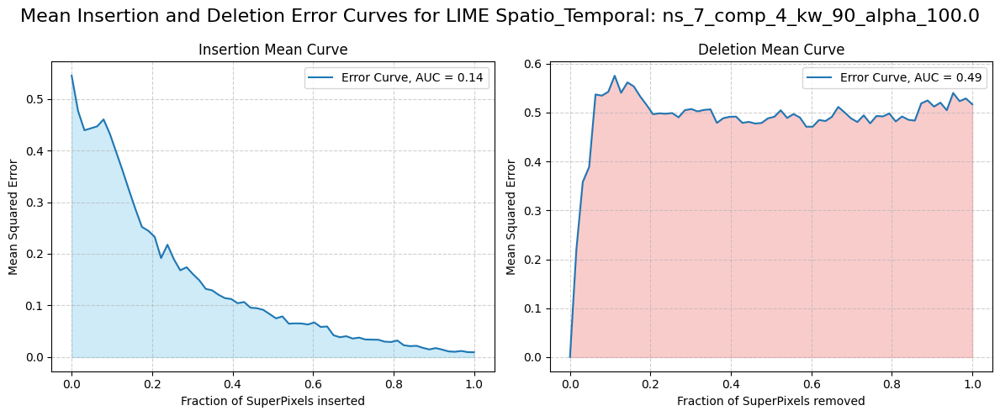

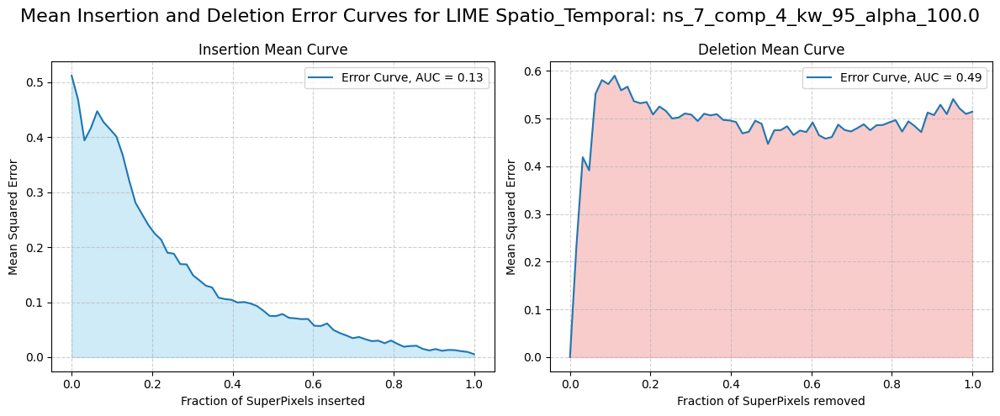

In [33]:
import pickle

n_segments  = 7
compactness = 4

#results_setups_path = "./MyDrive/Water_Resources/wr_extensions/superpixels_versions/LIME/last_try/Temporal/results/lime_temporal_insertion_deletion_results_setup_kw_80_alpha_0.pkl"
path_to_load_results = os.path.join(work_path, "Water_Resources/rise-video/XAI/spatial_temporal/results/lime_shap_multiplicative_norm_zero/")
results_string_name  = f"lime_shap_st_results_setup_ns_{n_segments}_comp_{compactness}.pkl"

# Apri il file in modalità lettura binaria ('rb')
with open(path_to_load_results + results_string_name, 'rb') as file:
    lime_shap_st_results = pickle.load(file)

for parameter_combination in lime_shap_st_results["lime"]:
    all_errors_insertion = lime_shap_st_results["lime"][parameter_combination]["errors_insertion"]
    all_errors_deletion  = lime_shap_st_results["lime"][parameter_combination]["errors_deletion"]

    plot_combined_curves(all_errors_insertion, all_errors_deletion, parameter_combination)

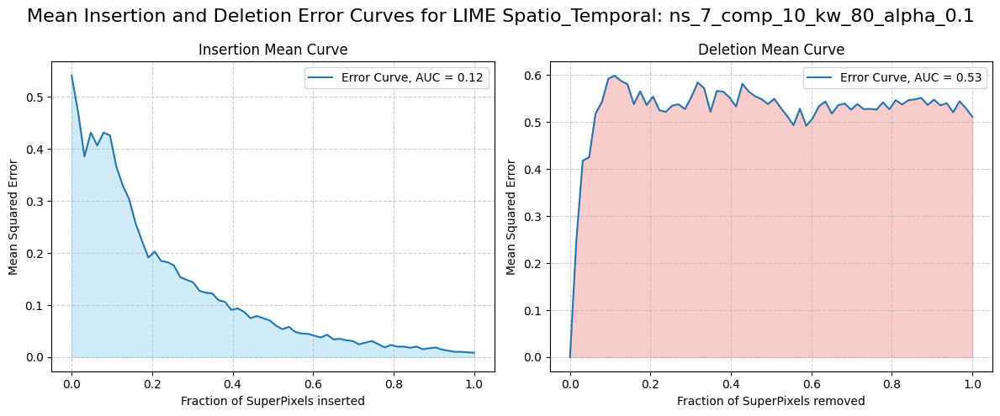

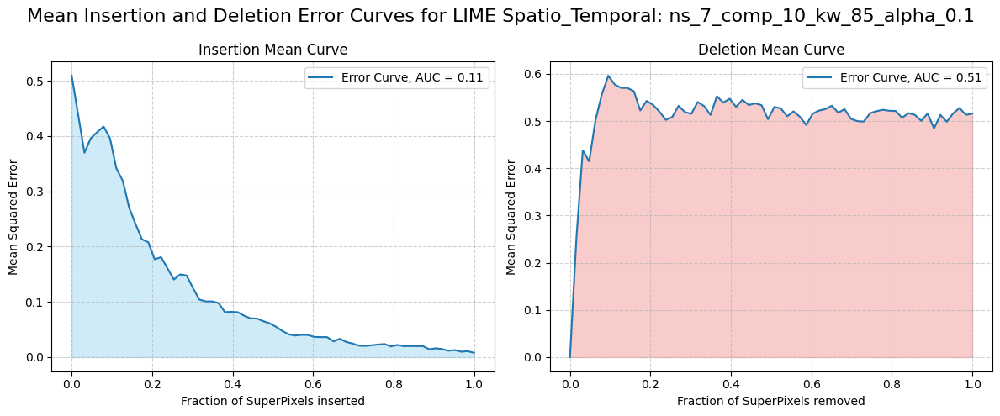

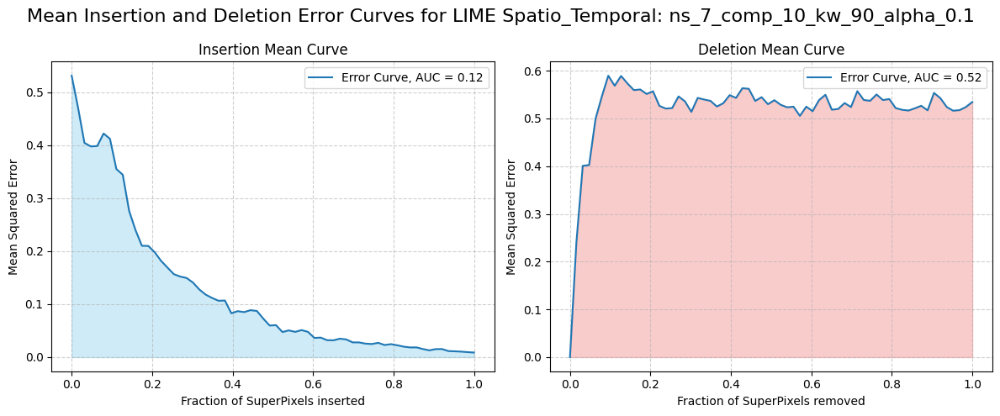

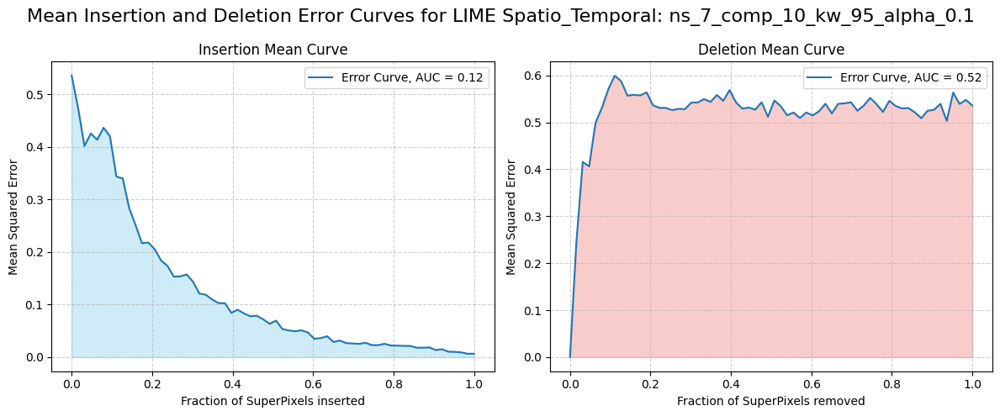

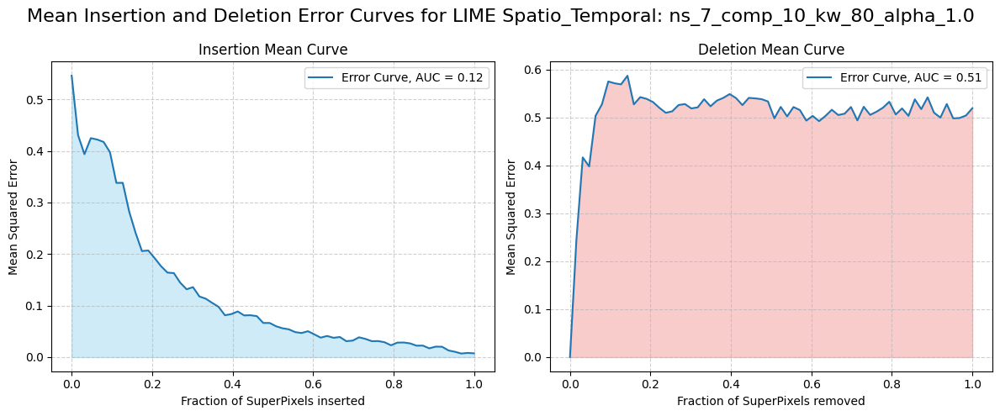

...

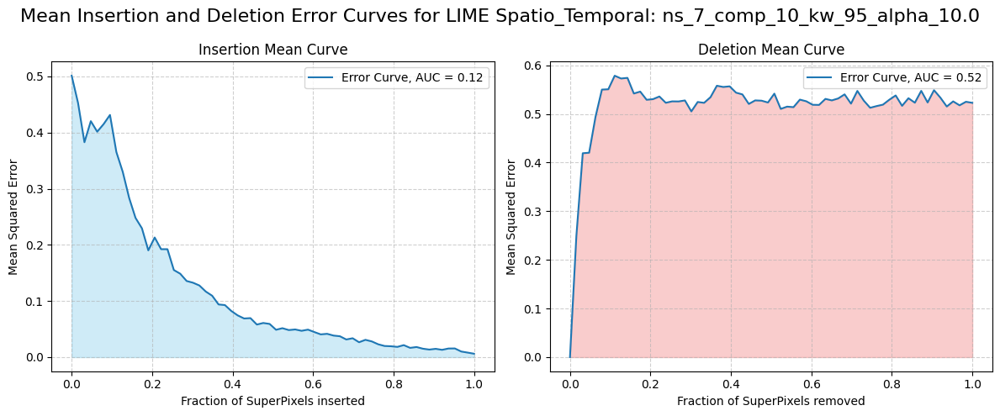

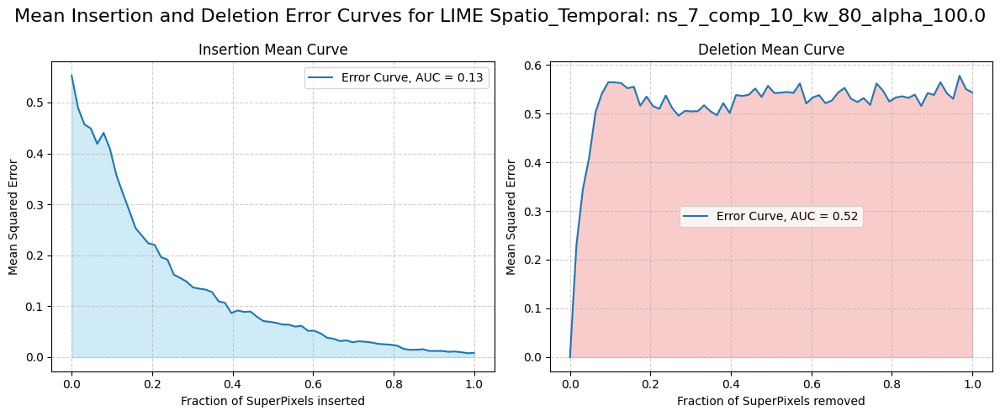

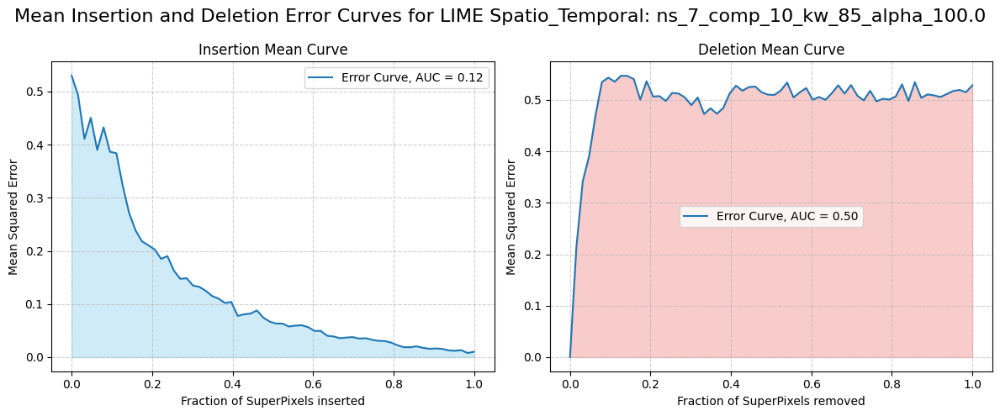

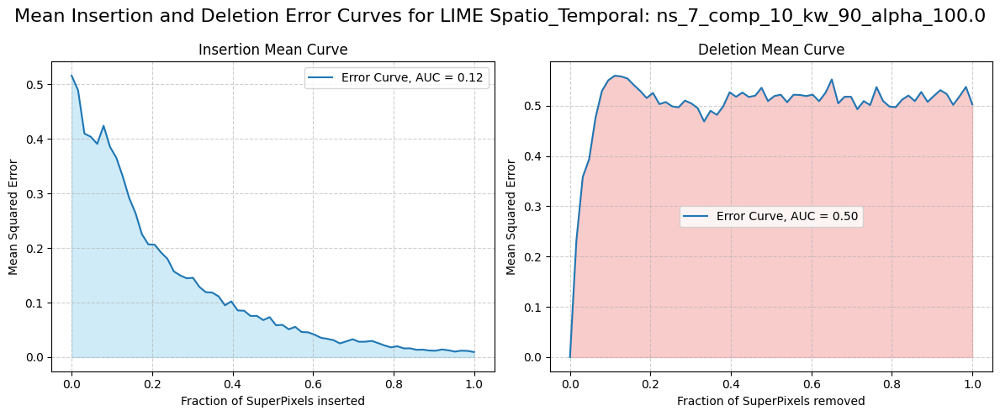

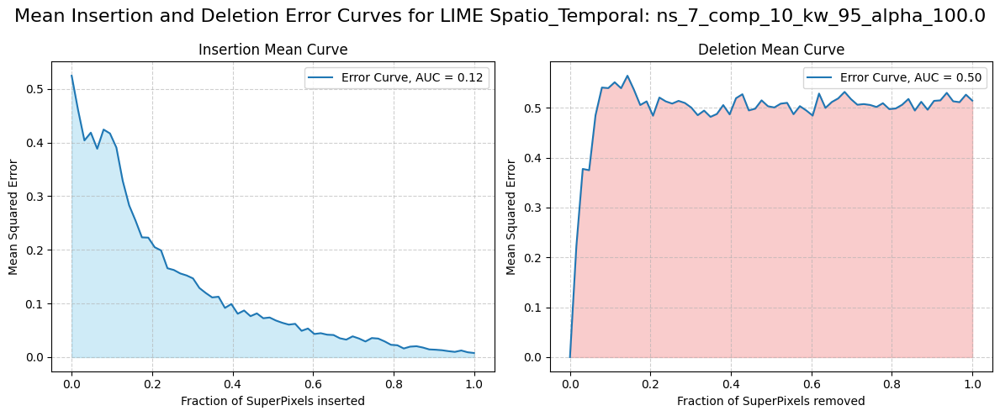

In [34]:
import pickle

n_segments  = 7
compactness = 10

#results_setups_path = "./MyDrive/Water_Resources/wr_extensions/superpixels_versions/LIME/last_try/Temporal/results/lime_temporal_insertion_deletion_results_setup_kw_80_alpha_0.pkl"
path_to_load_results = os.path.join(work_path, "Water_Resources/rise-video/XAI/spatial_temporal/results/lime_shap_multiplicative_norm_zero/")
results_string_name  = f"lime_shap_st_results_setup_ns_{n_segments}_comp_{compactness}.pkl"

# Apri il file in modalità lettura binaria ('rb')
with open(path_to_load_results + results_string_name, 'rb') as file:
    lime_shap_st_results = pickle.load(file)

for parameter_combination in lime_shap_st_results["lime"]:
    all_errors_insertion = lime_shap_st_results["lime"][parameter_combination]["errors_insertion"]
    all_errors_deletion  = lime_shap_st_results["lime"][parameter_combination]["errors_deletion"]

    plot_combined_curves(all_errors_insertion, all_errors_deletion, parameter_combination)

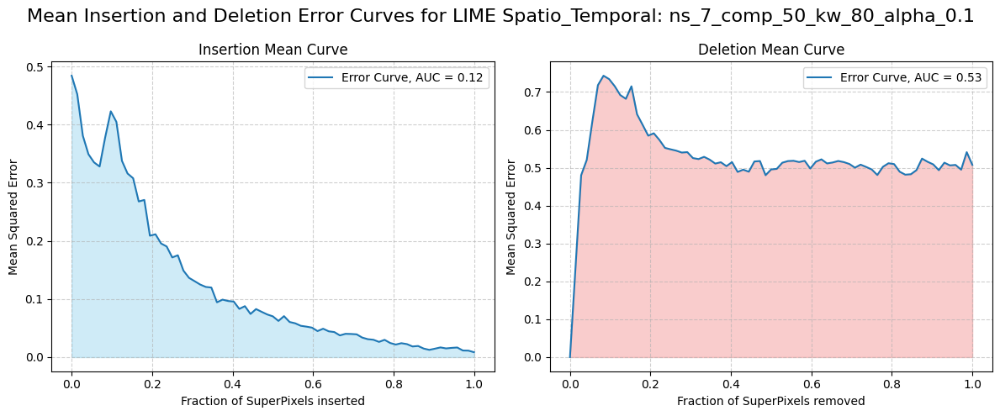

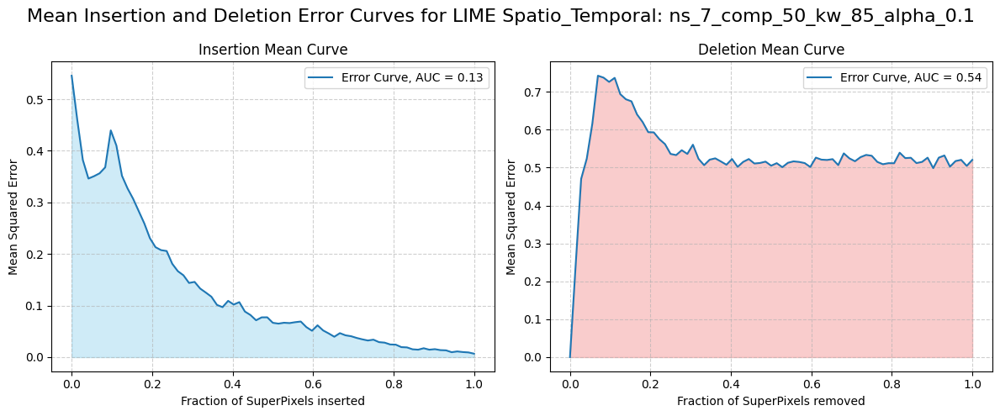

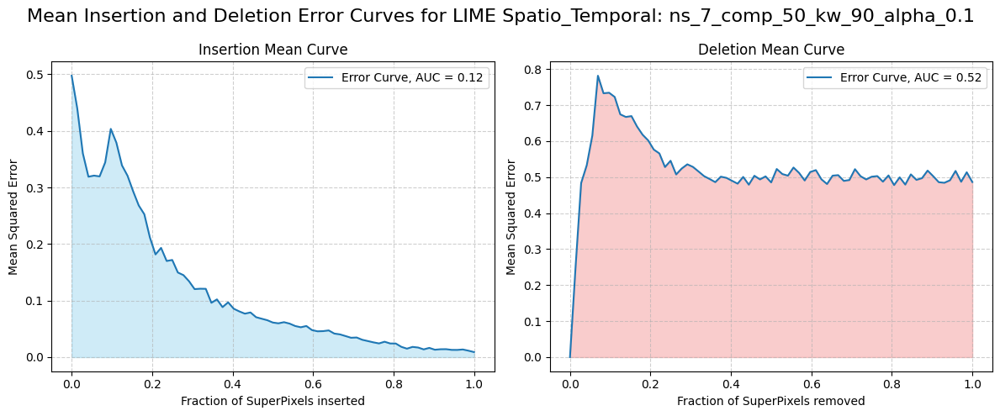

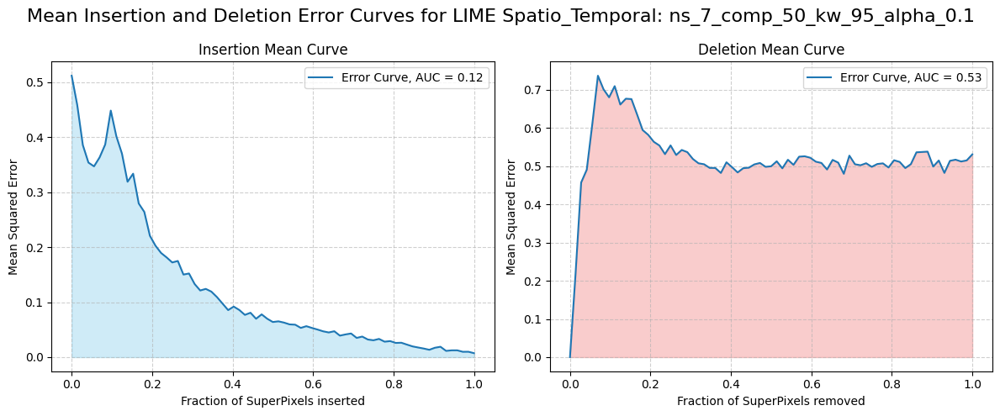

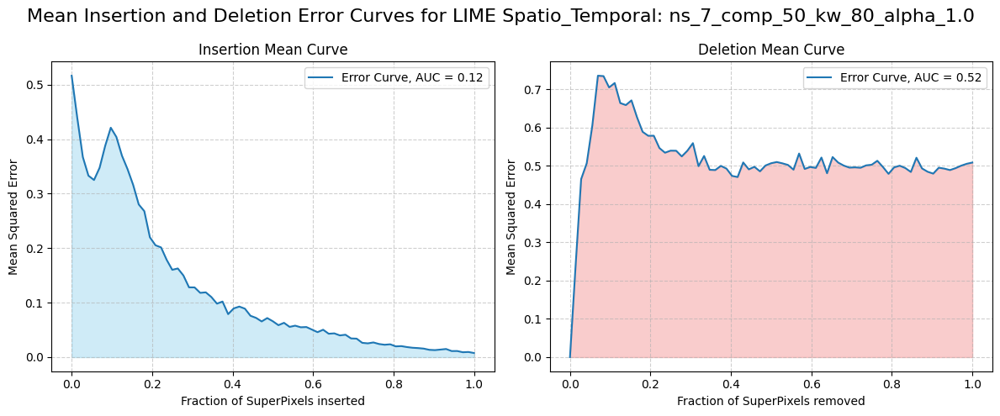

...

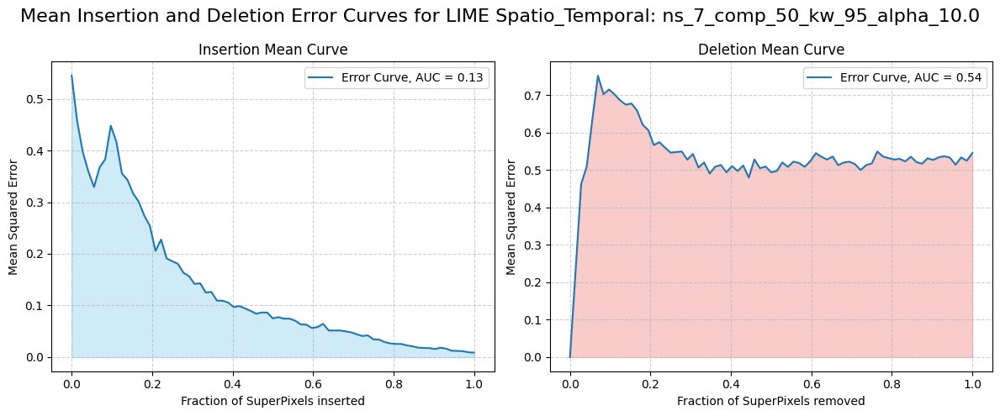

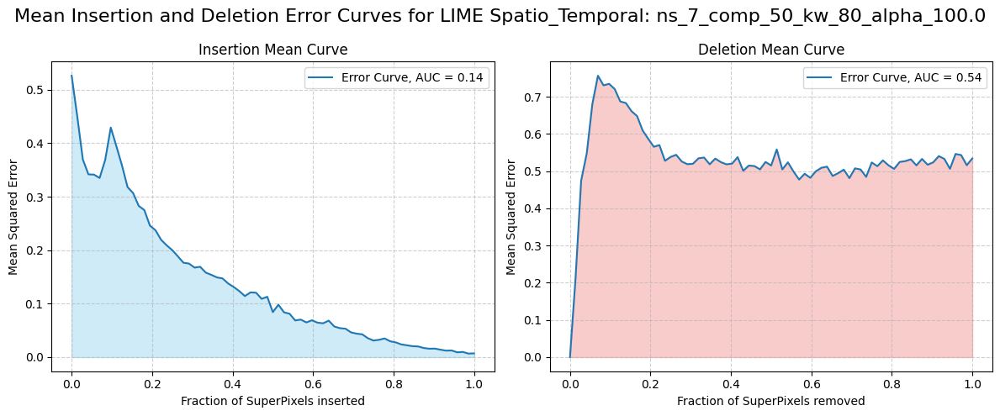

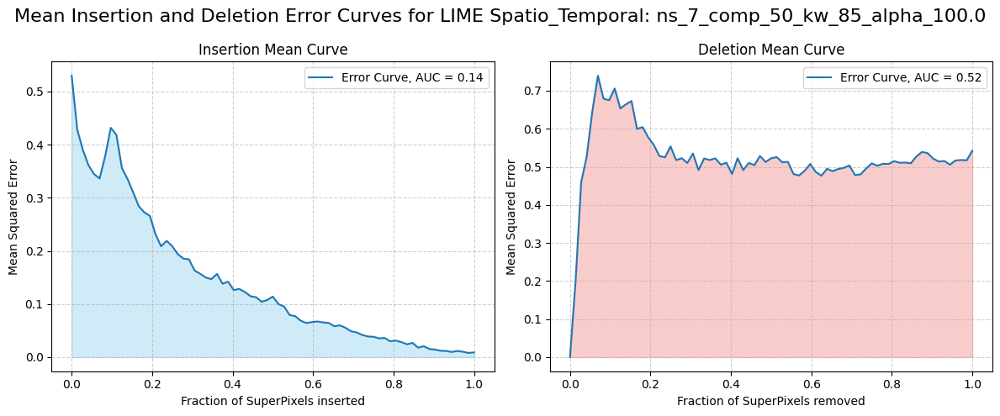

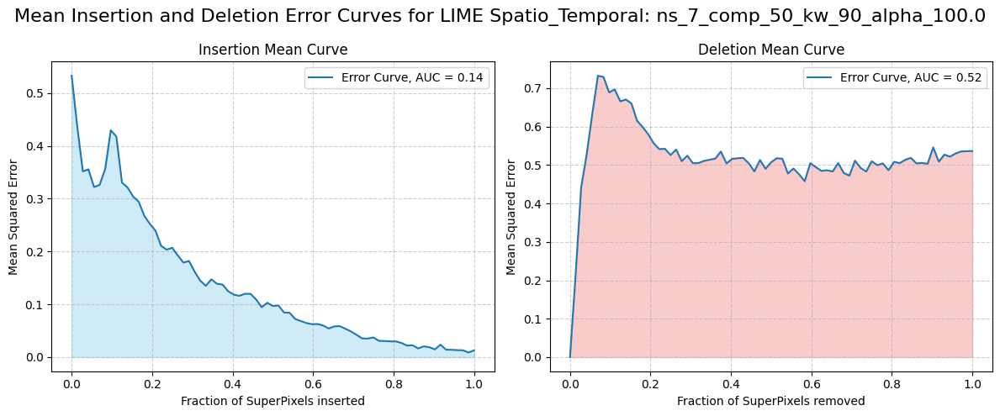

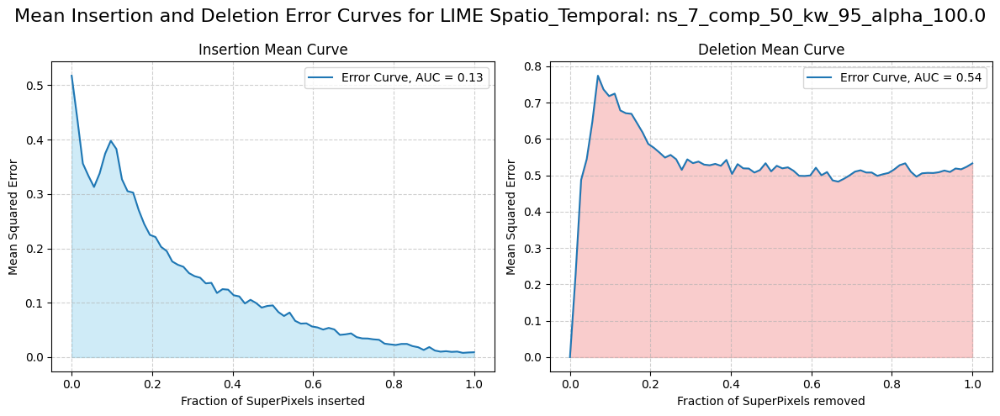

In [35]:
import pickle

n_segments  = 7
compactness = 50

#results_setups_path = "./MyDrive/Water_Resources/wr_extensions/superpixels_versions/LIME/last_try/Temporal/results/lime_temporal_insertion_deletion_results_setup_kw_80_alpha_0.pkl"
path_to_load_results = os.path.join(work_path, "Water_Resources/rise-video/XAI/spatial_temporal/results/lime_shap_multiplicative_norm_zero/")
results_string_name  = f"lime_shap_st_results_setup_ns_{n_segments}_comp_{compactness}.pkl"

# Apri il file in modalità lettura binaria ('rb')
with open(path_to_load_results + results_string_name, 'rb') as file:
    lime_shap_st_results = pickle.load(file)

for parameter_combination in lime_shap_st_results["lime"]:
    all_errors_insertion = lime_shap_st_results["lime"][parameter_combination]["errors_insertion"]
    all_errors_deletion  = lime_shap_st_results["lime"][parameter_combination]["errors_deletion"]

    plot_combined_curves(all_errors_insertion, all_errors_deletion, parameter_combination)

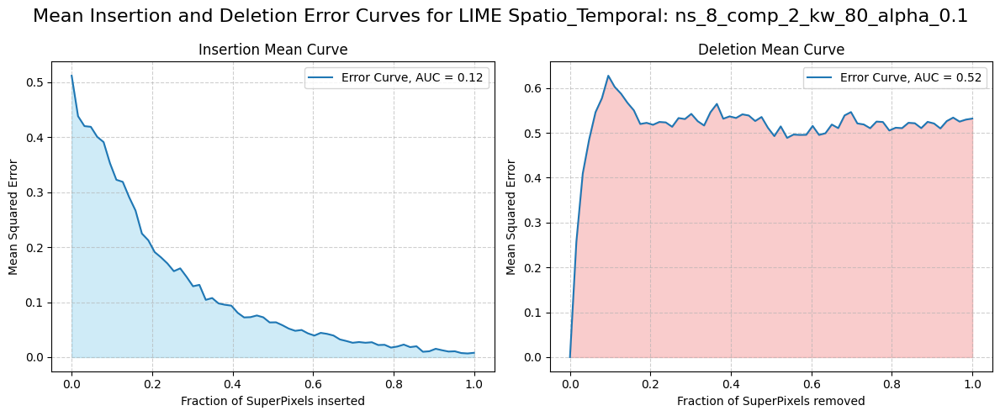

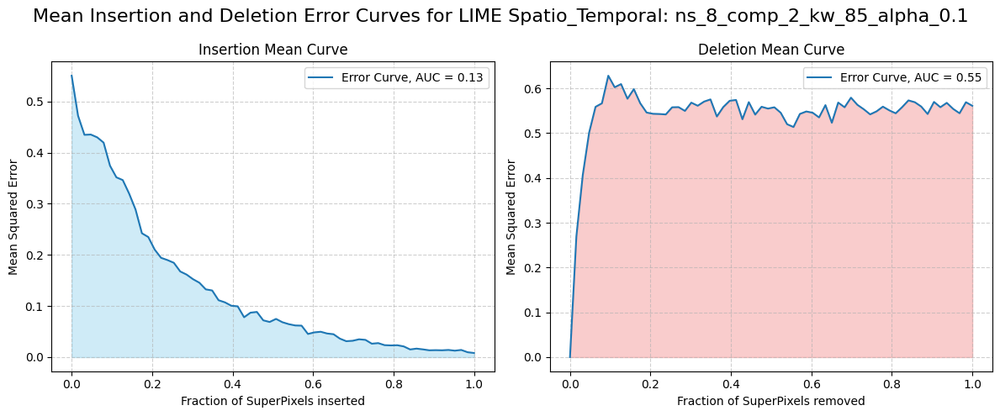

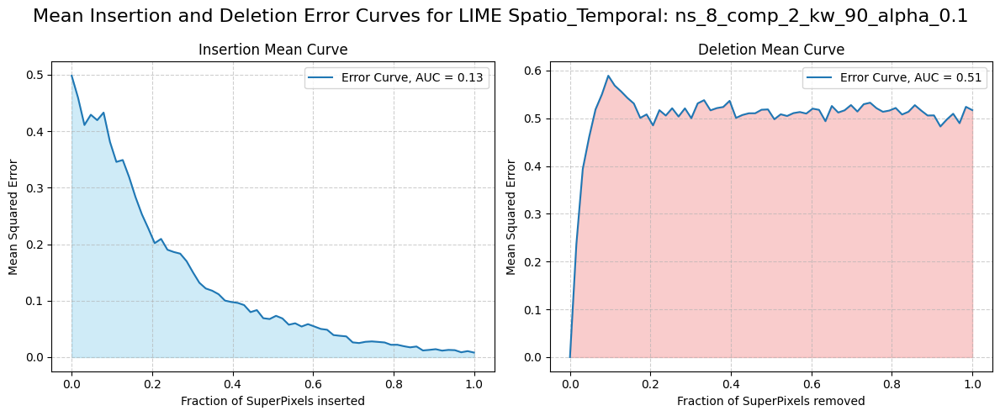

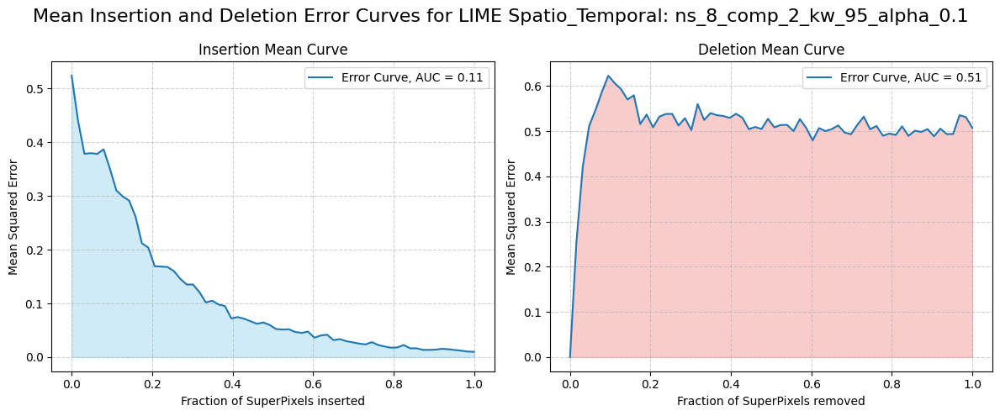

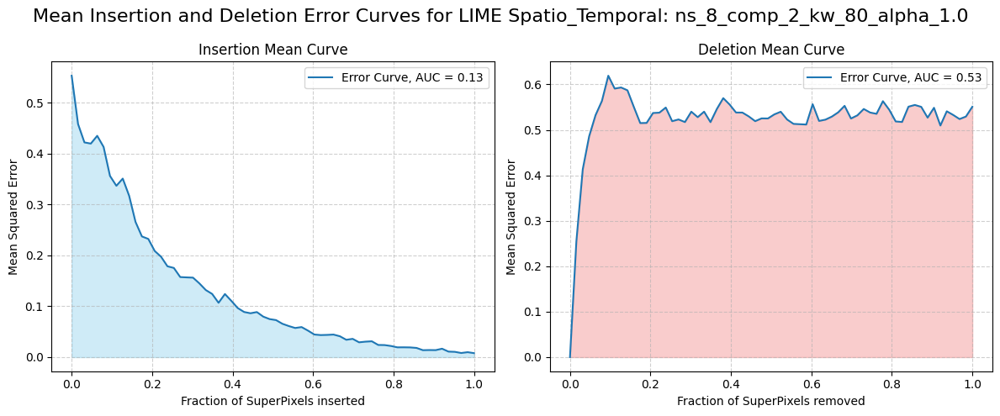

...

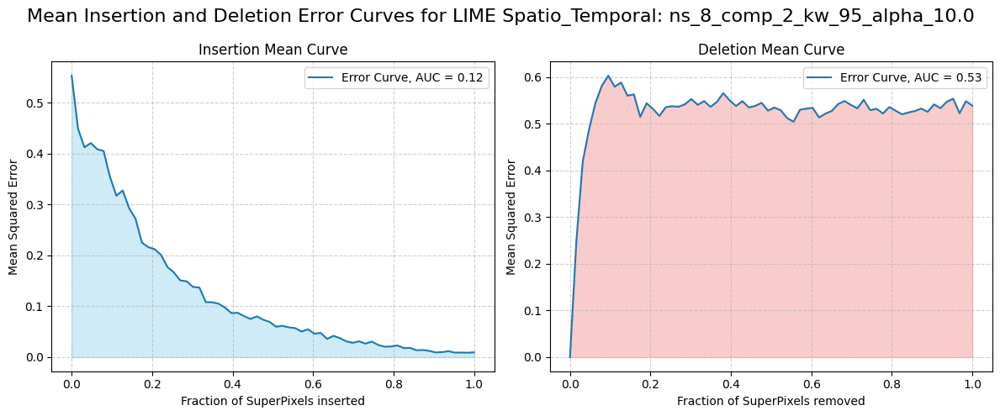

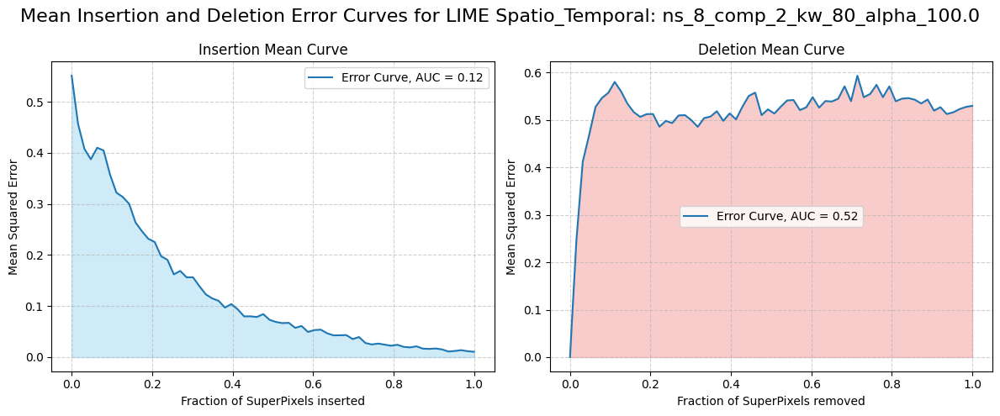

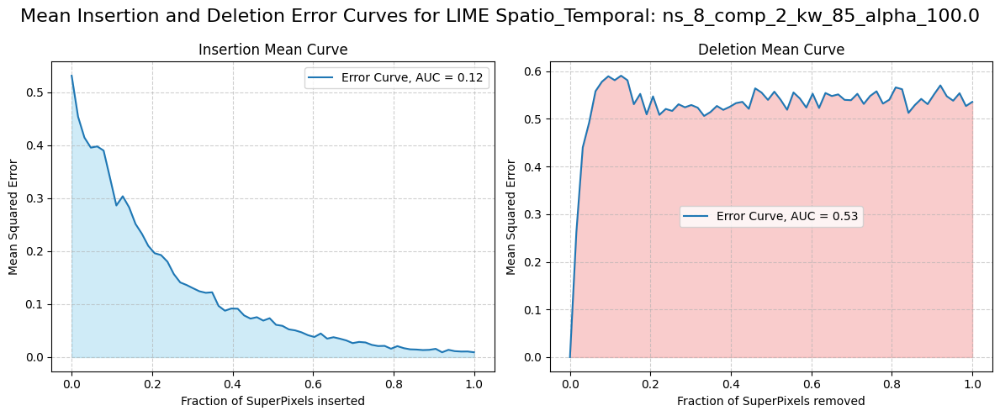

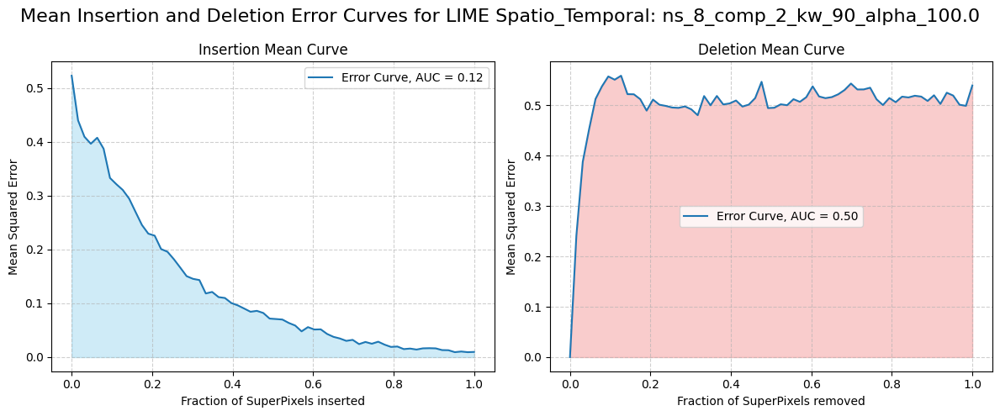

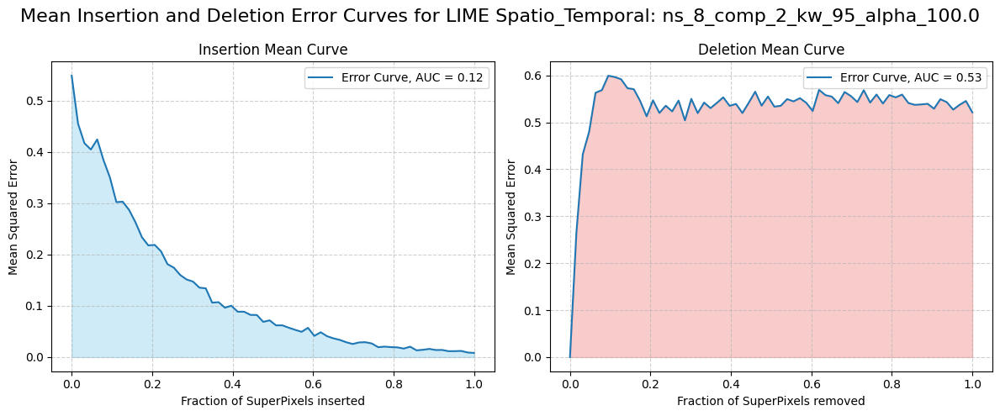

In [36]:
import pickle

n_segments  = 8
compactness = 2

#results_setups_path = "./MyDrive/Water_Resources/wr_extensions/superpixels_versions/LIME/last_try/Temporal/results/lime_temporal_insertion_deletion_results_setup_kw_80_alpha_0.pkl"
path_to_load_results = os.path.join(work_path, "Water_Resources/rise-video/XAI/spatial_temporal/results/lime_shap_multiplicative_norm_zero/")
results_string_name  = f"lime_shap_st_results_setup_ns_{n_segments}_comp_{compactness}.pkl"

# Apri il file in modalità lettura binaria ('rb')
with open(path_to_load_results + results_string_name, 'rb') as file:
    lime_shap_st_results = pickle.load(file)

for parameter_combination in lime_shap_st_results["lime"]:
    all_errors_insertion = lime_shap_st_results["lime"][parameter_combination]["errors_insertion"]
    all_errors_deletion  = lime_shap_st_results["lime"][parameter_combination]["errors_deletion"]

    plot_combined_curves(all_errors_insertion, all_errors_deletion, parameter_combination)

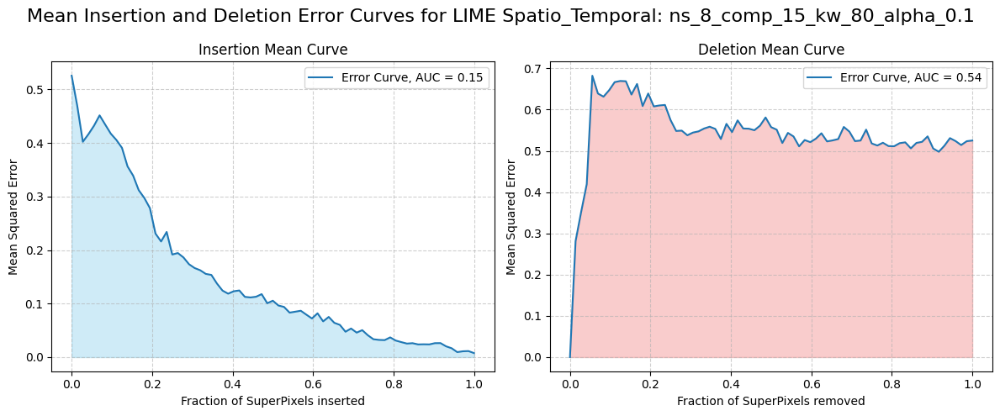

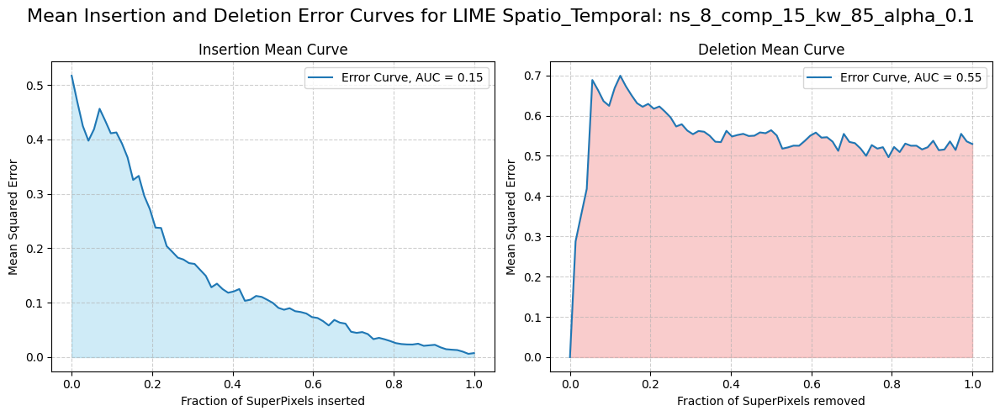

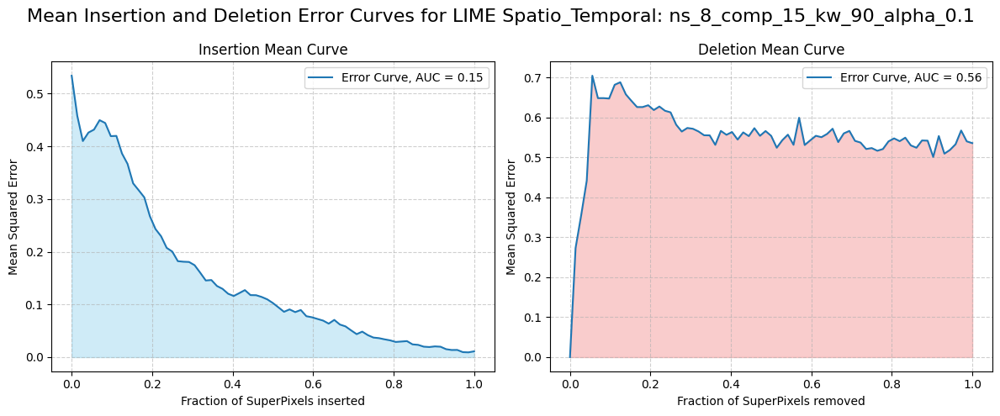

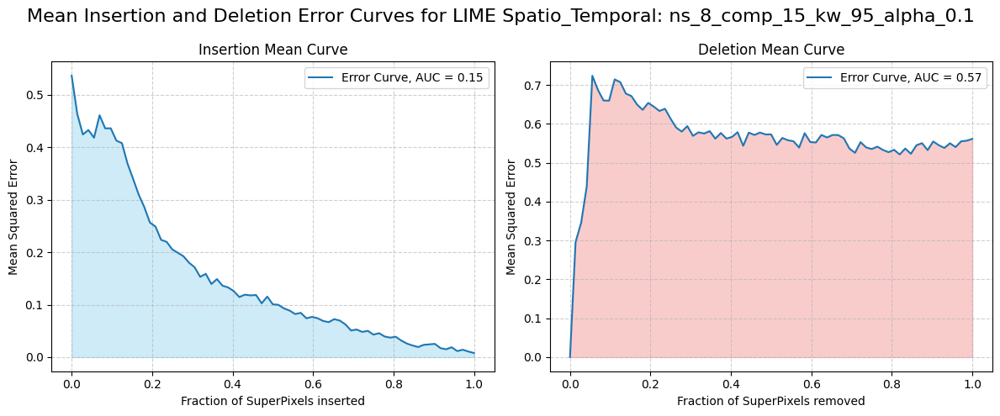

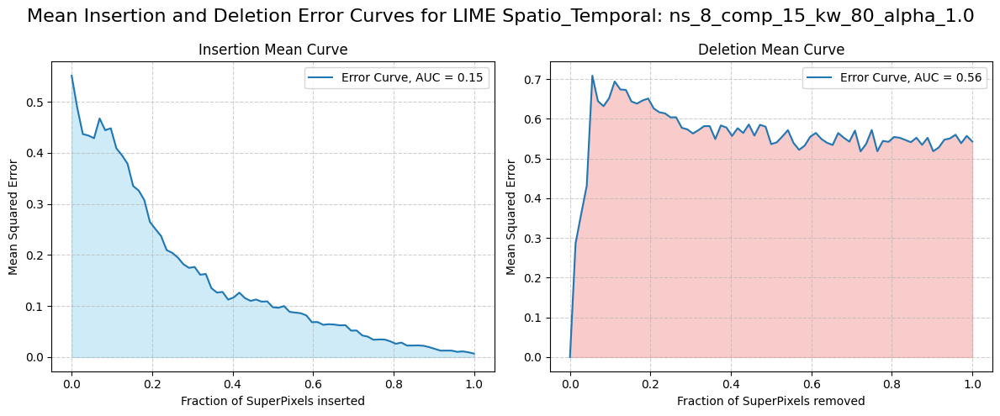

...

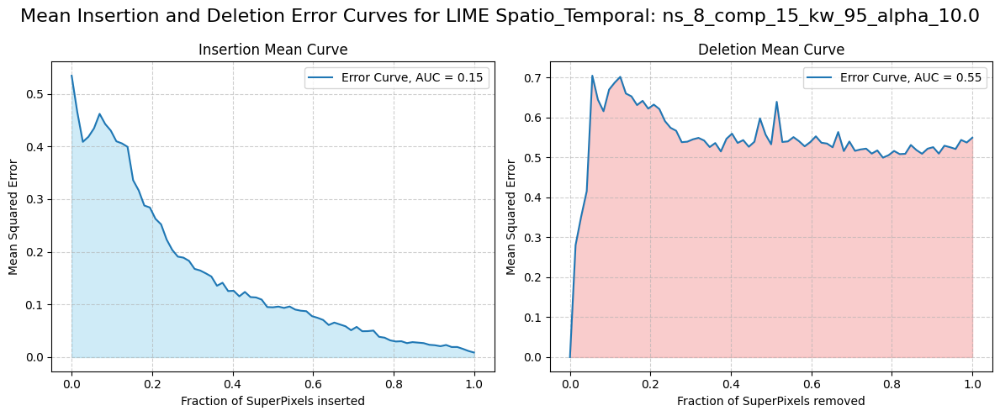

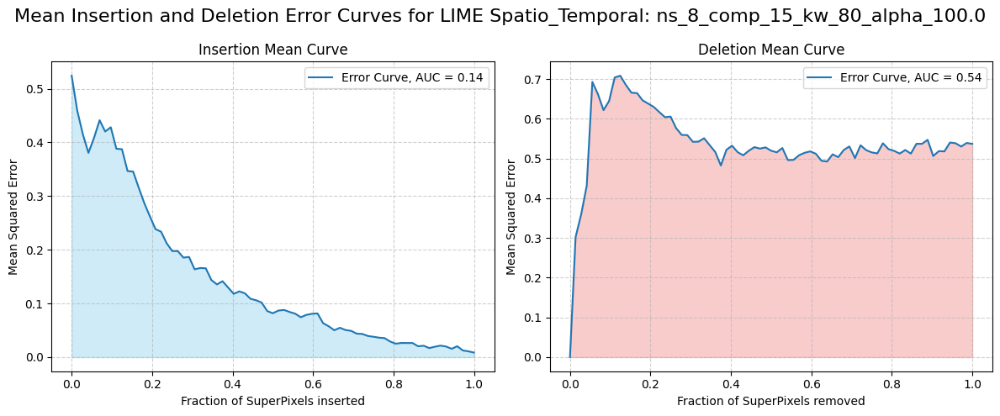

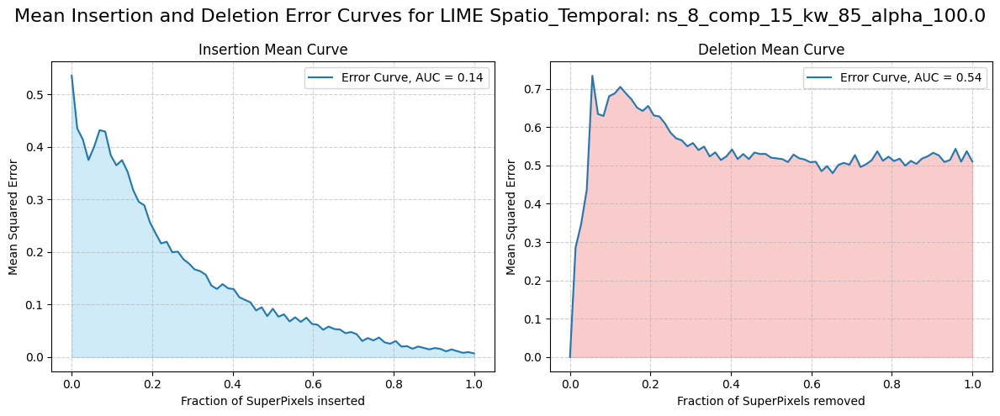

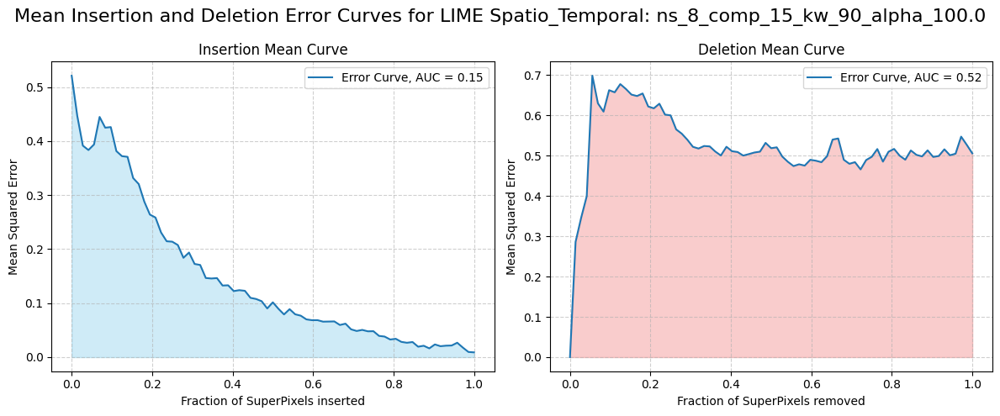

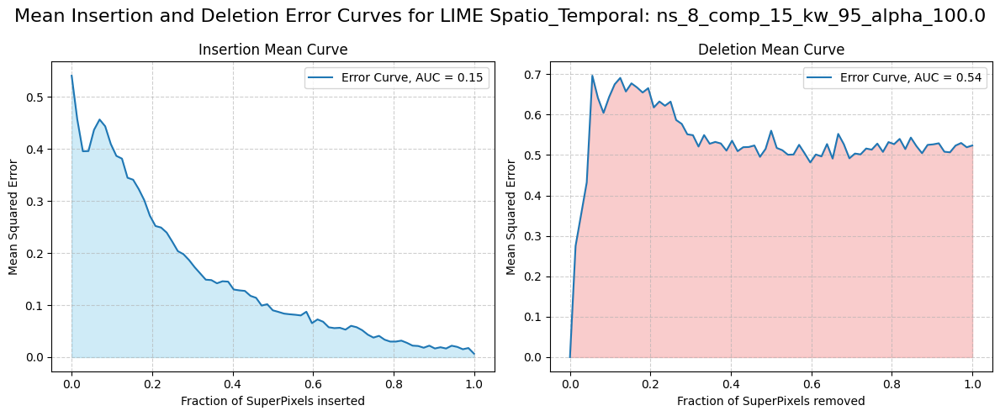

In [37]:
import pickle

n_segments  = 8
compactness = 15

#results_setups_path = "./MyDrive/Water_Resources/wr_extensions/superpixels_versions/LIME/last_try/Temporal/results/lime_temporal_insertion_deletion_results_setup_kw_80_alpha_0.pkl"
path_to_load_results = os.path.join(work_path, "Water_Resources/rise-video/XAI/spatial_temporal/results/lime_shap_multiplicative_norm_zero/")
results_string_name  = f"lime_shap_st_results_setup_ns_{n_segments}_comp_{compactness}.pkl"

# Apri il file in modalità lettura binaria ('rb')
with open(path_to_load_results + results_string_name, 'rb') as file:
    lime_shap_st_results = pickle.load(file)

for parameter_combination in lime_shap_st_results["lime"]:
    all_errors_insertion = lime_shap_st_results["lime"][parameter_combination]["errors_insertion"]
    all_errors_deletion  = lime_shap_st_results["lime"][parameter_combination]["errors_deletion"]

    plot_combined_curves(all_errors_insertion, all_errors_deletion, parameter_combination)

ns_9_comp_20_kw_80_alpha_0.1


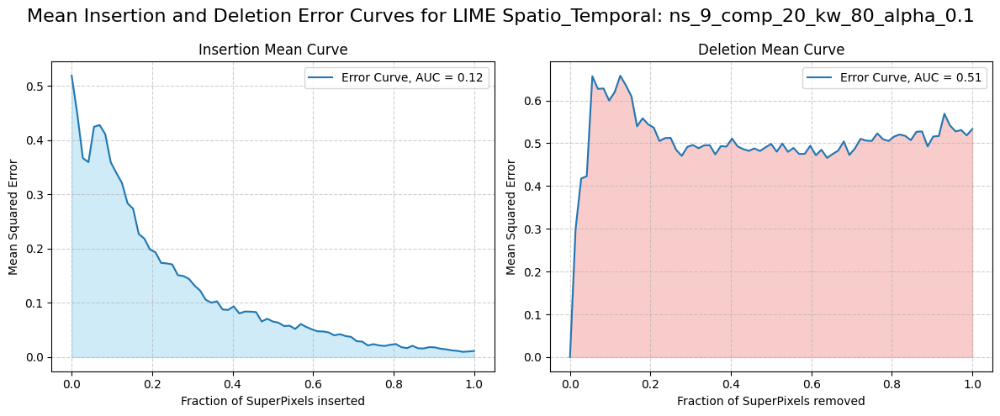

ns_9_comp_20_kw_85_alpha_0.1


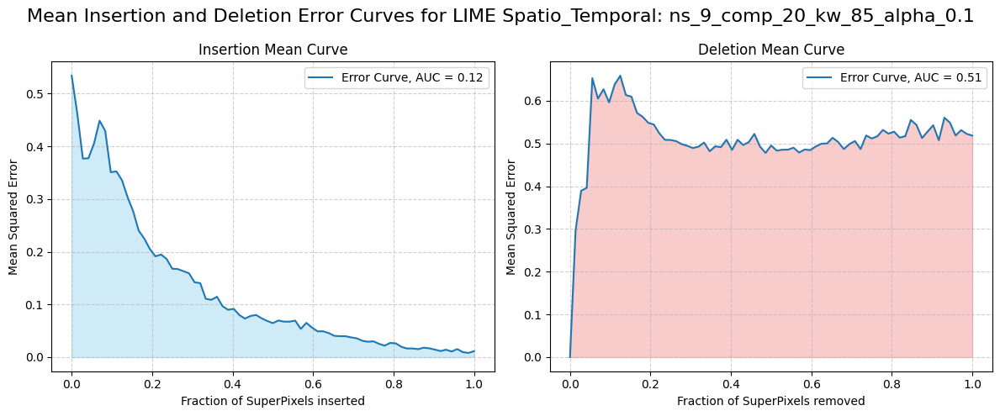

ns_9_comp_20_kw_90_alpha_0.1


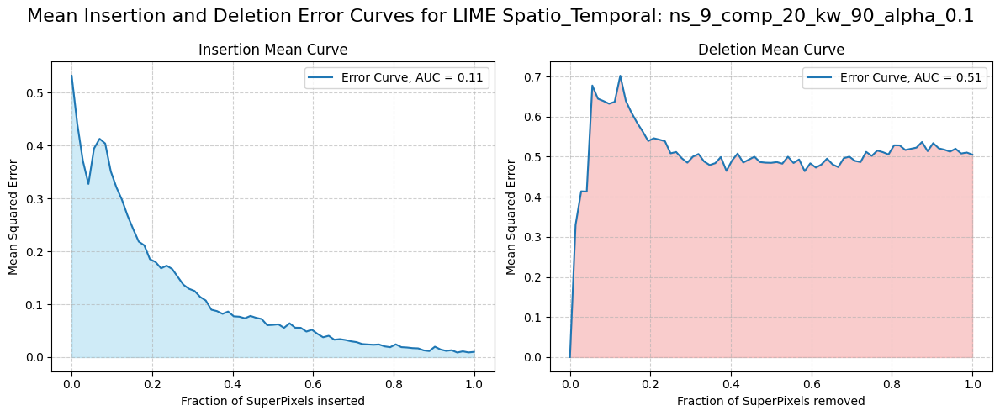

ns_9_comp_20_kw_95_alpha_0.1


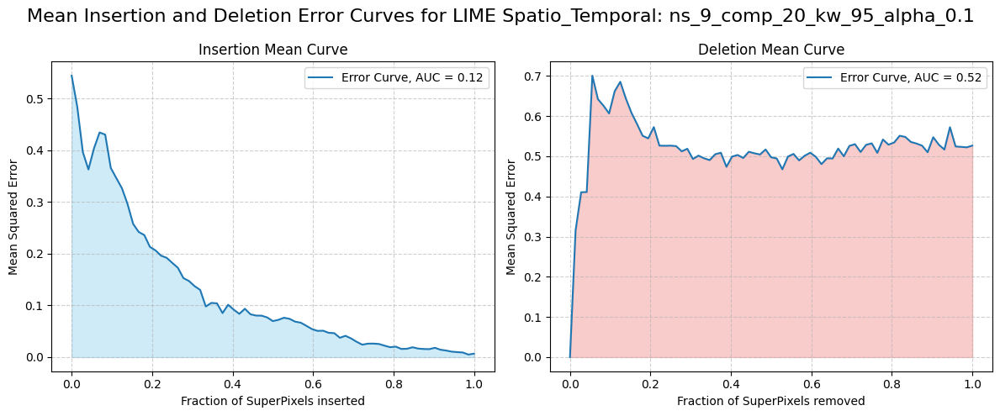

ns_9_comp_20_kw_80_alpha_1.0


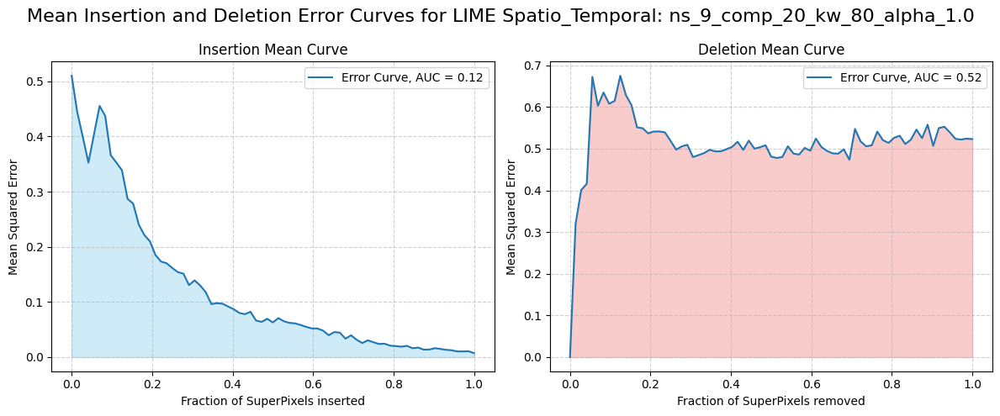

ns_9_comp_20_kw_85_alpha_1.0


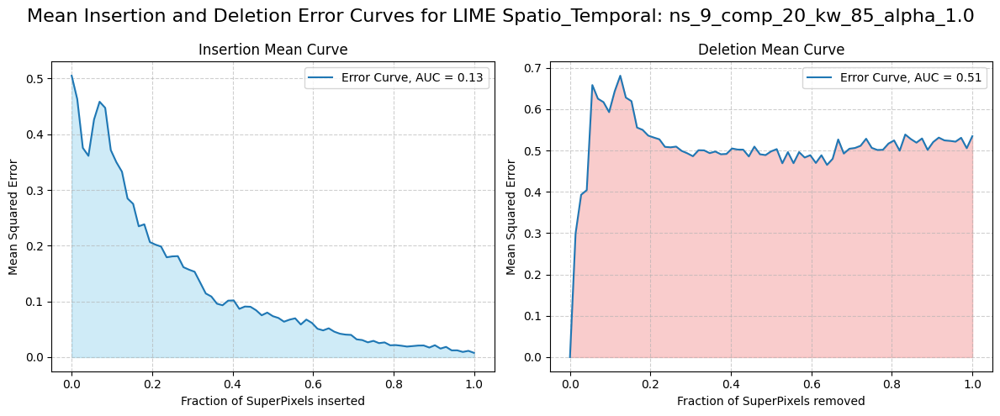

ns_9_comp_20_kw_90_alpha_1.0


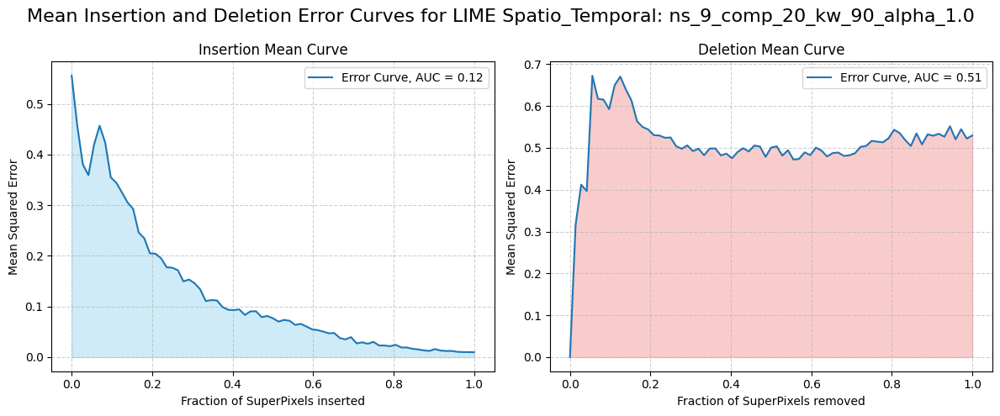

ns_9_comp_20_kw_95_alpha_1.0


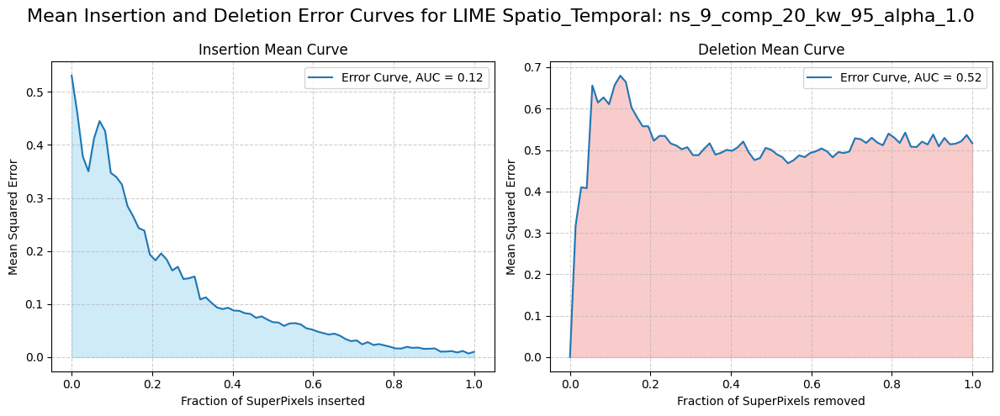

ns_9_comp_20_kw_80_alpha_10.0


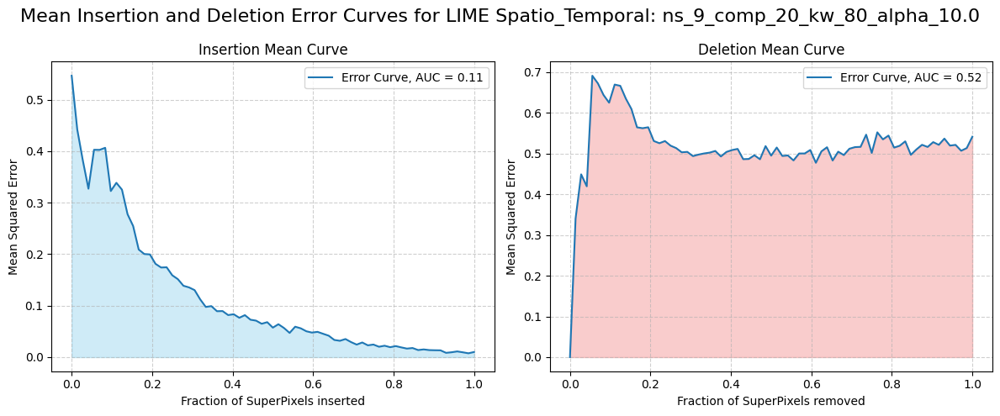

ns_9_comp_20_kw_85_alpha_10.0


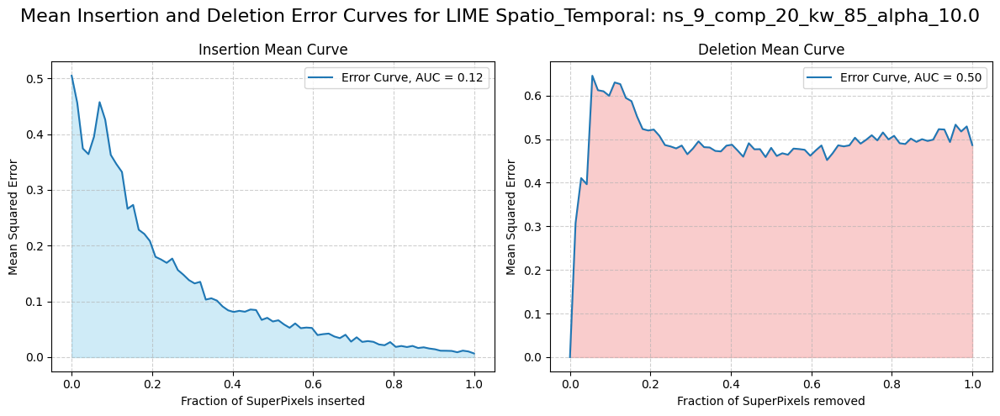

ns_9_comp_20_kw_90_alpha_10.0


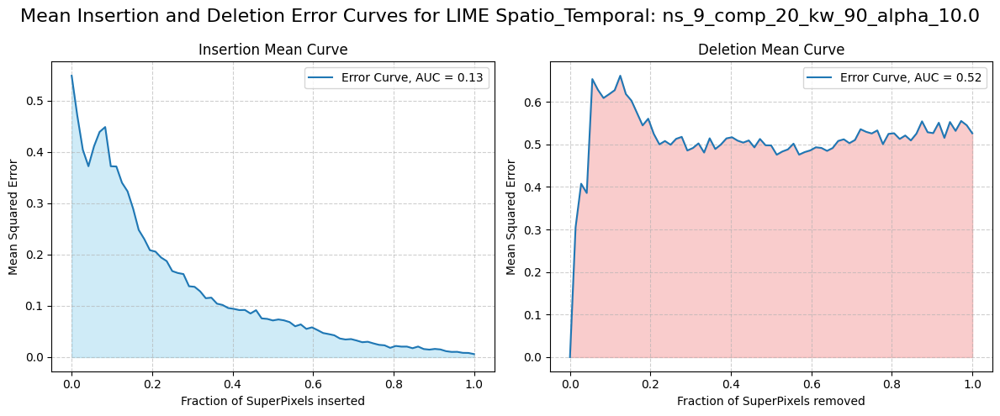

ns_9_comp_20_kw_95_alpha_10.0


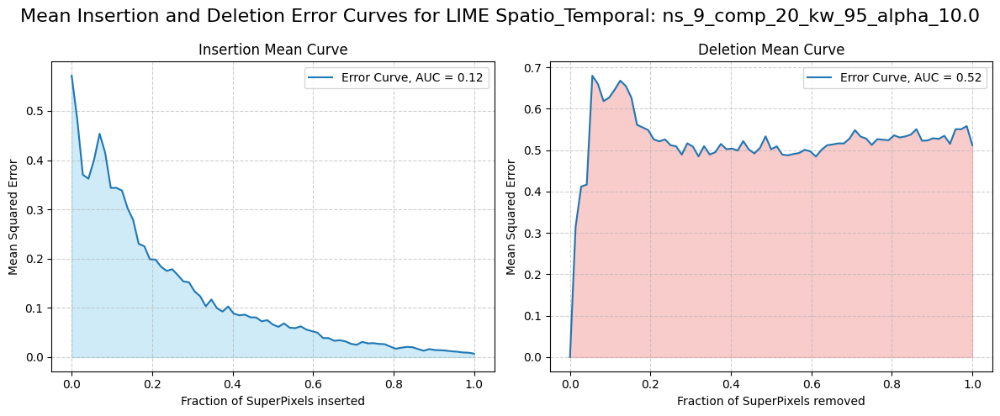

ns_9_comp_20_kw_80_alpha_100.0


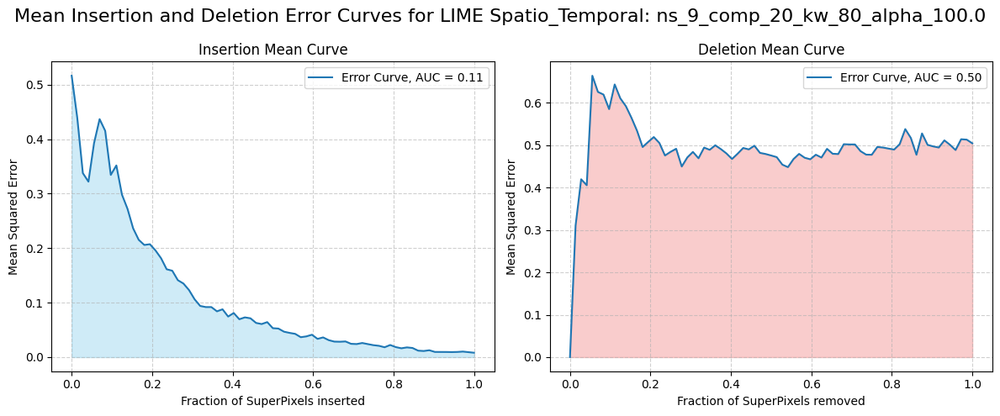

ns_9_comp_20_kw_85_alpha_100.0


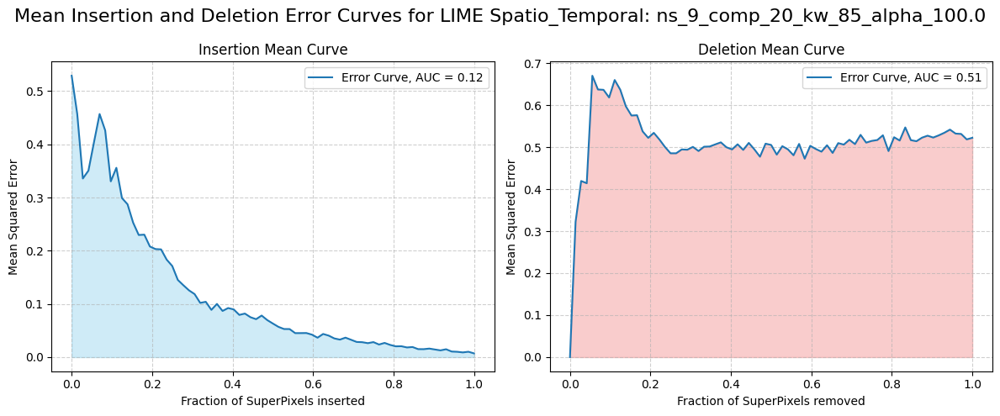

ns_9_comp_20_kw_90_alpha_100.0


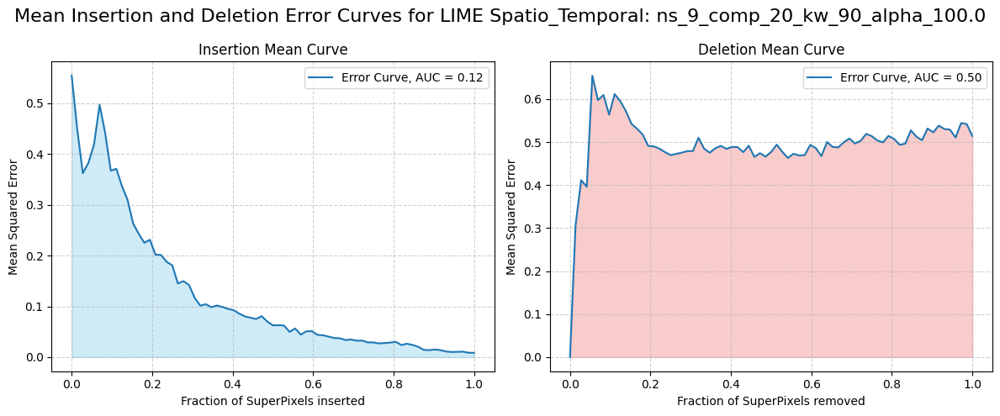

ns_9_comp_20_kw_95_alpha_100.0


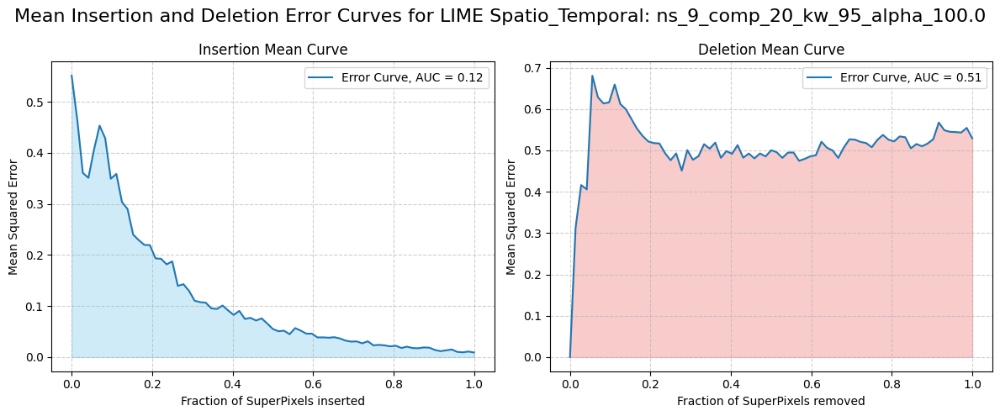

In [39]:
import pickle

n_segments  = 9
compactness = 20

#results_setups_path = "./MyDrive/Water_Resources/wr_extensions/superpixels_versions/LIME/last_try/Temporal/results/lime_temporal_insertion_deletion_results_setup_kw_80_alpha_0.pkl"
path_to_load_results = os.path.join(work_path, "Water_Resources/rise-video/XAI/spatial_temporal/results/lime_shap_multiplicative_norm_zero/")
results_string_name  = f"lime_shap_st_results_setup_ns_{n_segments}_comp_{compactness}.pkl"

# Apri il file in modalità lettura binaria ('rb')
with open(path_to_load_results + results_string_name, 'rb') as file:
    lime_shap_st_results = pickle.load(file)

for parameter_combination in lime_shap_st_results["lime"]:
    print(parameter_combination)
    all_errors_insertion = lime_shap_st_results["lime"][parameter_combination]["errors_insertion"]
    all_errors_deletion  = lime_shap_st_results["lime"][parameter_combination]["errors_deletion"]

    plot_combined_curves(all_errors_insertion, all_errors_deletion, parameter_combination)

In [48]:
slic_param = [(4,4),(4,5),(4,6),(4,10),(4,25),(4,50),
              (7,4),(7,10),(7,50),
              (8,2),(8,15),
              (9,20)]

for n_segments,compactness in slic_param:
    #n_segments, compactness = param
    print(n_segments,compactness)

4 4
4 5
4 6
4 10
4 25
4 50
7 4
7 10
7 50
8 2
8 15
9 20


ns_4_comp_4


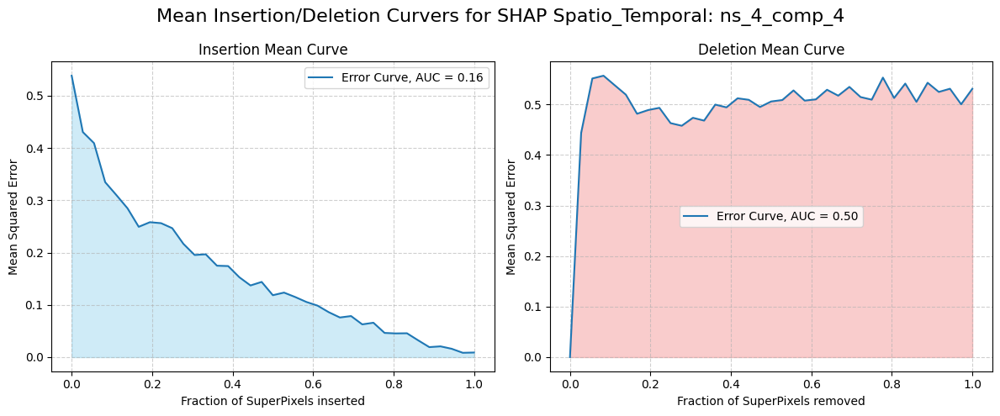

ns_4_comp_5


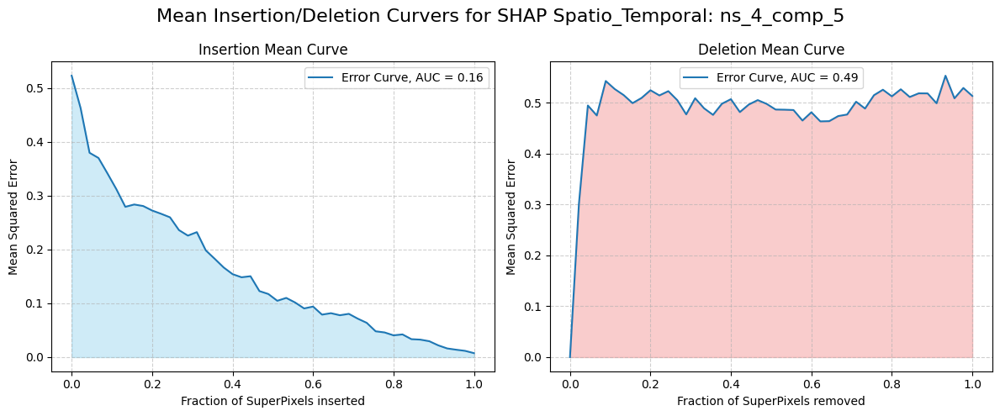

ns_4_comp_6


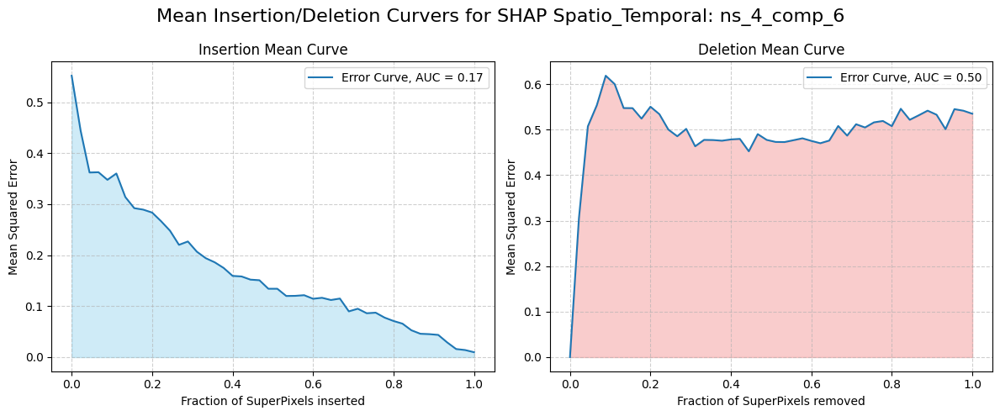

ns_4_comp_10


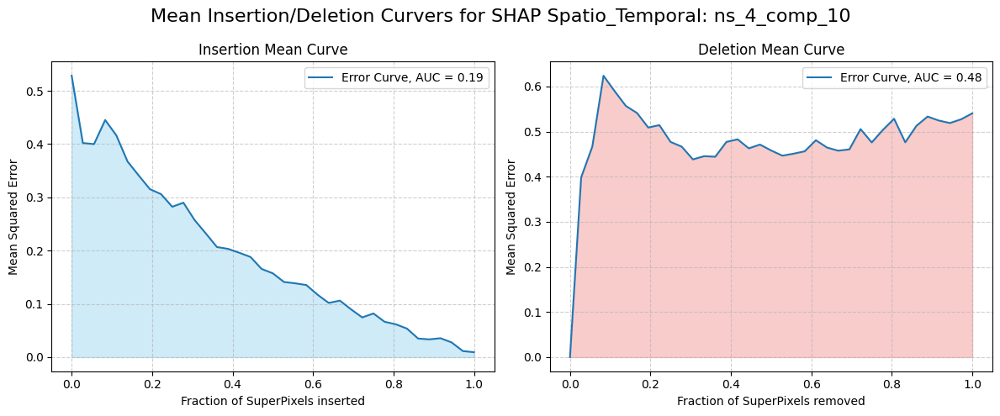

ns_4_comp_25


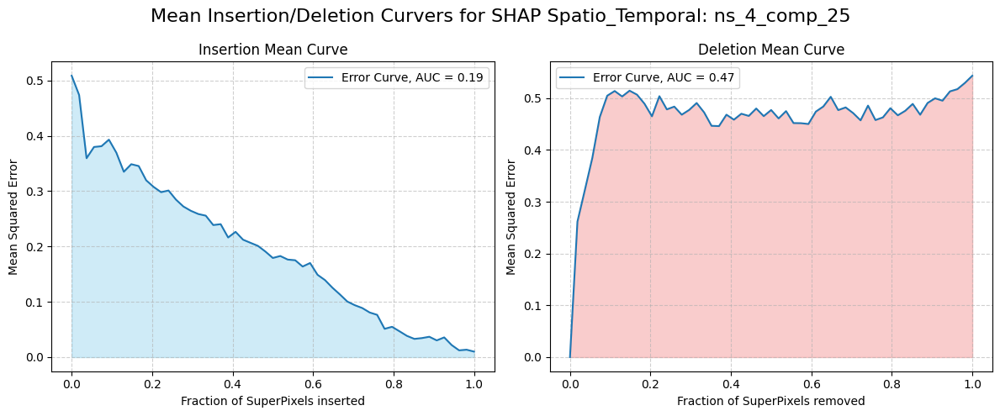

ns_4_comp_50


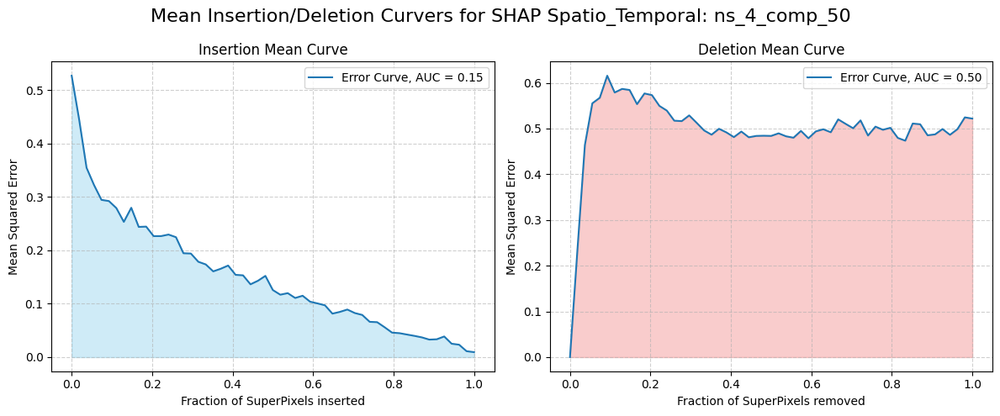

ns_7_comp_4


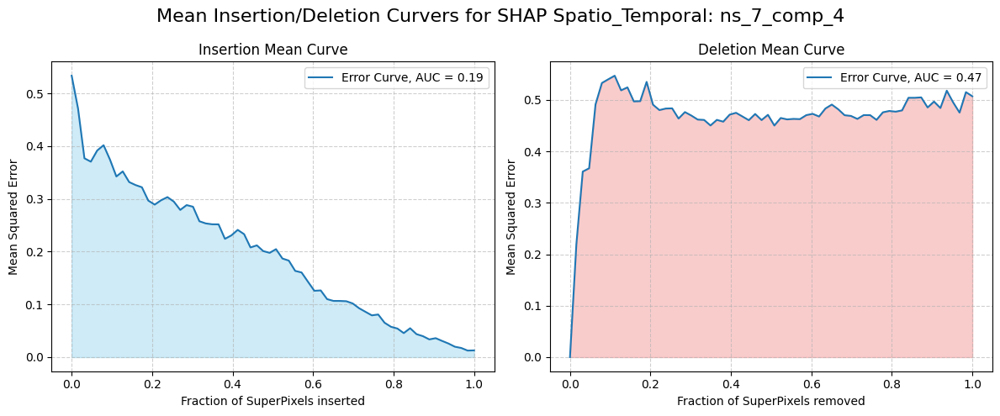

ns_7_comp_10


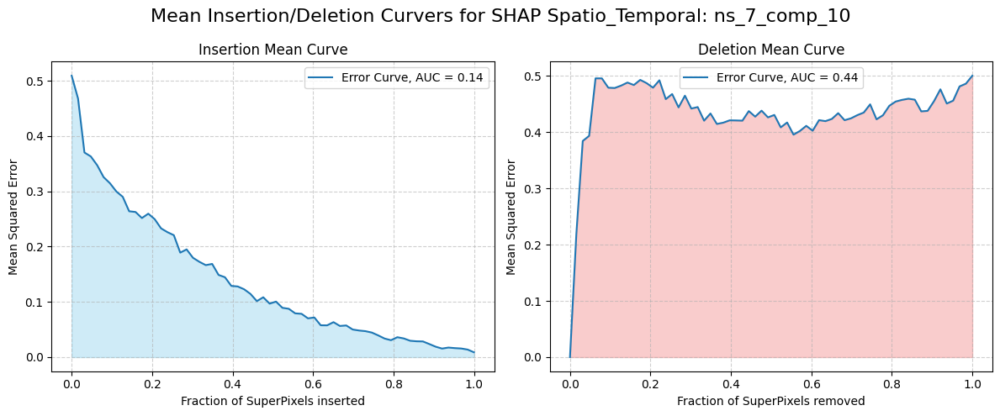

ns_7_comp_50


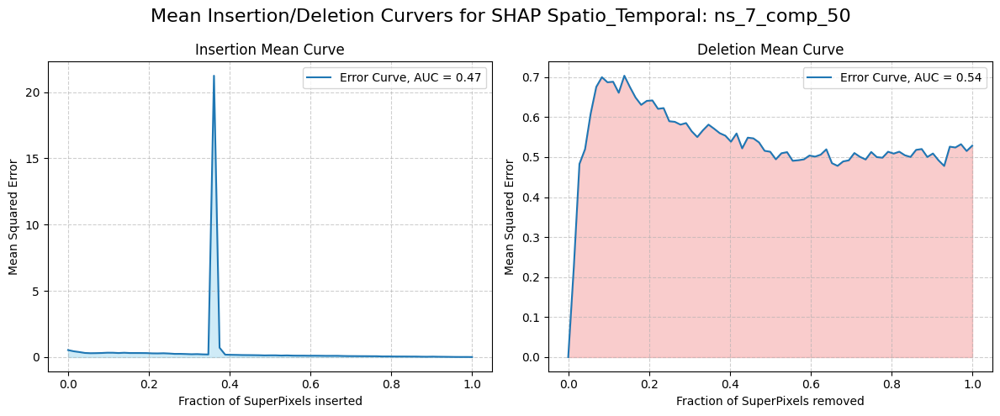

ns_8_comp_2


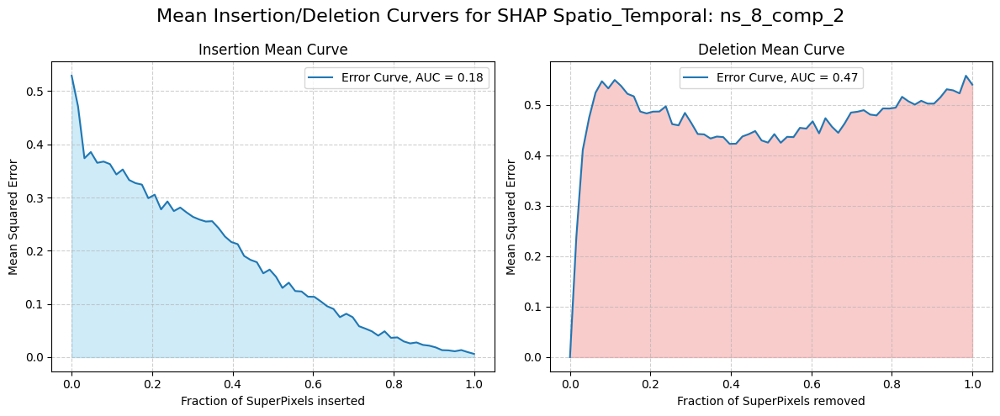

ns_8_comp_15


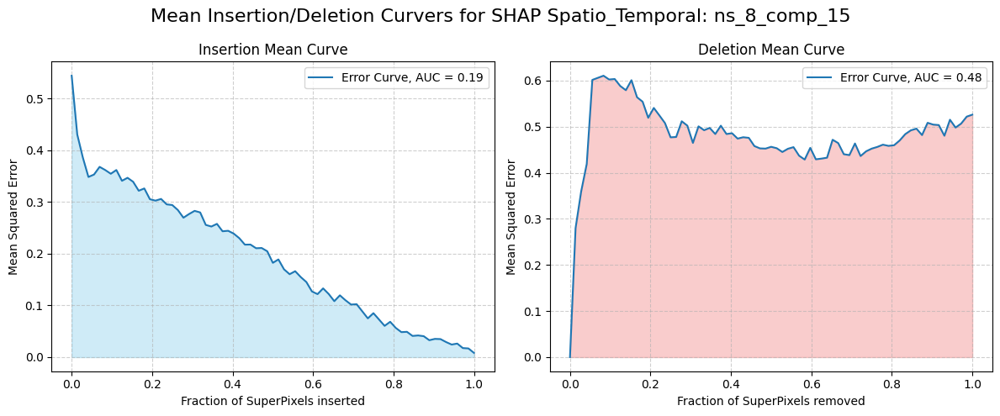

ns_9_comp_20


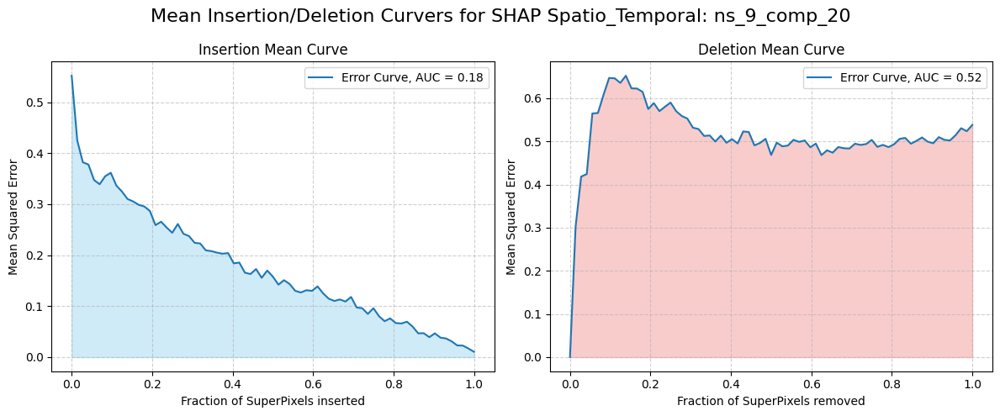

In [49]:
import pickle

alg = "shap"

slic_param = [(4,4),(4,5),(4,6),(4,10),(4,25),(4,50),
              (7,4),(7,10),(7,50),
              (8,2),(8,15),
              (9,20)]

for n_segments,compactness in slic_param:

    #results_setups_path = "./MyDrive/Water_Resources/wr_extensions/superpixels_versions/LIME/last_try/Temporal/results/lime_temporal_insertion_deletion_results_setup_kw_80_alpha_0.pkl"
    path_to_load_results = os.path.join(work_path, "Water_Resources/rise-video/XAI/spatial_temporal/results/lime_shap_multiplicative_norm_zero/")
    results_string_name  = f"lime_shap_st_results_setup_ns_{n_segments}_comp_{compactness}.pkl"

    # Apri il file in modalità lettura binaria ('rb')
    with open(path_to_load_results + results_string_name, 'rb') as file:
        lime_shap_st_results = pickle.load(file)

    for parameter_combination in lime_shap_st_results[alg]:
        print(parameter_combination)
        all_errors_insertion = lime_shap_st_results[alg][parameter_combination]["errors_insertion"]
        all_errors_deletion  = lime_shap_st_results[alg][parameter_combination]["errors_deletion"]

        plot_combined_curves(all_errors_insertion, all_errors_deletion, parameter_combination, f"Mean Insertion/Deletion Curvers for SHAP Spatio_Temporal: {parameter_combination}")